## IGO16318 - KP Hopx-MACD Rosa26-mTmG/+ traced mice
9/4/2024 - Data generated from 16 week KP Hopx-MACD/+ Rosa26-mTmG/+ tumors; data submitted by CHP/EB on 8/5/2024, analyzed by JC 9/4/2024,6/6/2025

Analyze global run on cellranger v8 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

from pathlib import Path
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
Path("./figures/umapfigures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [4]:
results_file = 'write/IGO16318-Hopx-16week.h5ad'  # the file that will store the analysis results

In [5]:
adata = sc.read_10x_h5('GSE277777_IGO16318-filtered_feature_bc_matrix.h5', gex_only=False)
#adata = sc.read_10x_h5('GSE277777_IGO16318-filtered_feature_bc_matrix-introns.h5', gex_only=False)

reading GSE277777_IGO16318-filtered_feature_bc_matrix.h5
 (0:00:04)


/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [7]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [8]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [9]:
hashadata.var

,gene_ids,feature_types,genome,pattern,read,sequence
BJ1822_B0301,BJ1822_B0301,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,ACCCACCAGTAAGAC
BJ1823_B0302,BJ1823_B0302,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GGTCGAGAGCATTCA
BJ1187_B0303,BJ1187_B0303,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTGCCGCATGTCAT
BJ1192_B0304,BJ1192_B0304,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,AAAGCATTCTTCACG
BJ1822_B0305,BJ1822_B0305,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTTGTCTTTGTGAG
BJ1823_B0306,BJ1823_B0306,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATGCTGCCACGGTA
BJ1187_B0308,BJ1187_B0308,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATAGAACGCCAGGC
BJ1192_B0310,BJ1192_B0310,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CCGATTGTAACAGAC


## Preprocessing

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


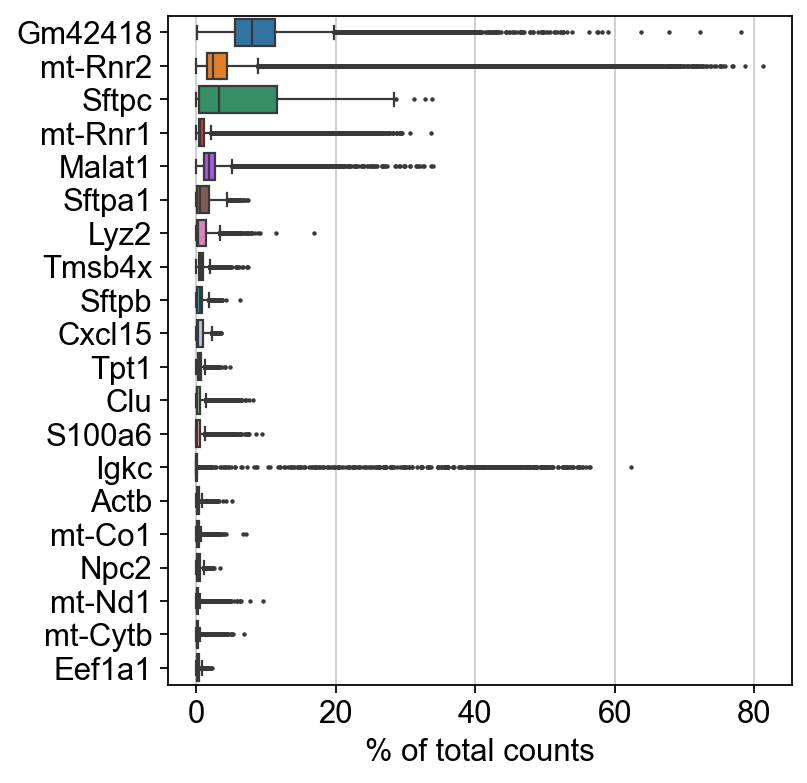

In [10]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [11]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 3112 cells that have less than 1500 counts
filtered out 1143 cells that have less than 300 genes expressed
filtered out 27294 genes that are detected in less than 3 cells


In [12]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

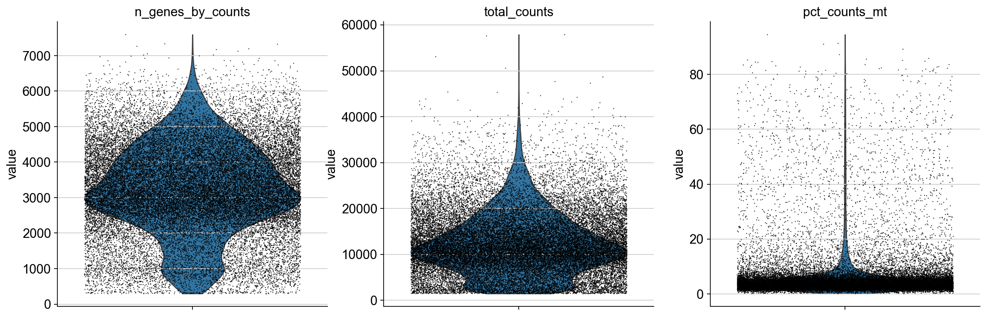

In [13]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([1.0000e+00, 8.0000e+00, 4.1000e+01, 1.2700e+02, 3.7400e+02,
        4.7700e+02, 1.3855e+04, 1.6161e+04, 1.5250e+03, 2.7000e+01]),
 array([0.62597985, 0.65949751, 0.69301517, 0.72653283, 0.76005048,
        0.79356814, 0.8270858 , 0.86060345, 0.89412111, 0.92763877,
        0.96115643]),
 <BarContainer object of 10 artists>)

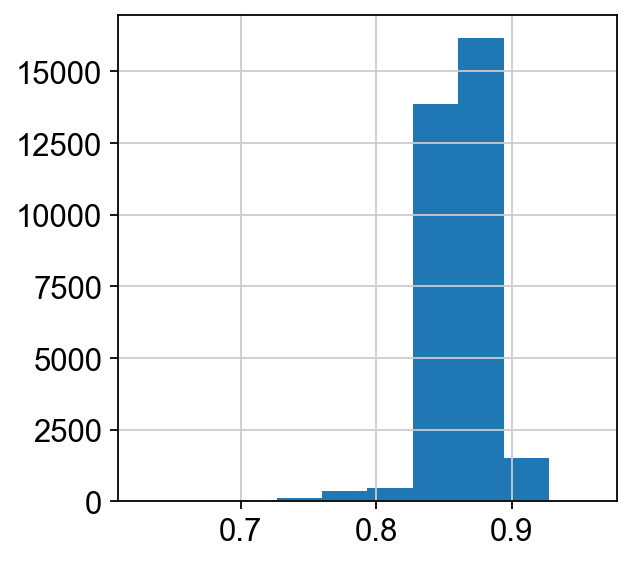

In [14]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

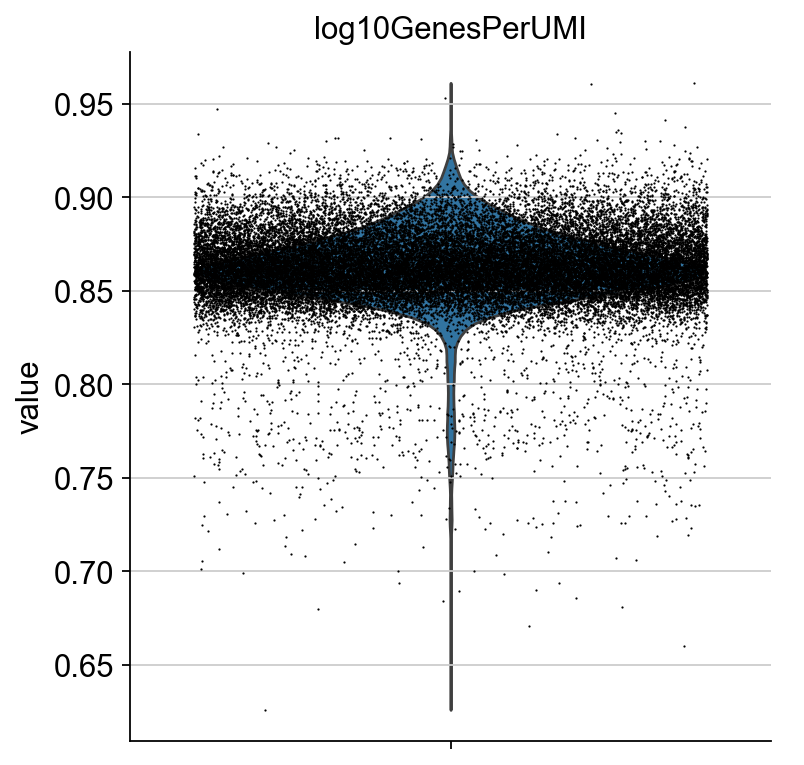

In [15]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)

In [16]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [17]:
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

In [18]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [19]:
hashadata.var_names

Index(['BJ1822_B0301', 'BJ1823_B0302', 'BJ1187_B0303', 'BJ1192_B0304',
       'BJ1822_B0305', 'BJ1823_B0306', 'BJ1187_B0308', 'BJ1192_B0310'],
      dtype='object')

In [20]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [21]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99])
#hashDisc

In [22]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
#hashIDs

BJ1822_B0301
762.0
BJ1823_B0302
3620.400000000005
BJ1187_B0303
121.20000000000073
BJ1192_B0304
198.0
BJ1822_B0305
1141.0
BJ1823_B0306
104.0
BJ1187_B0308
2360.2000000000007
BJ1192_B0310
310.0


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False  True ... False  True False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a f

In [23]:
from matplotlib import pyplot as plt

In [24]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.figsize'] = (3,4)

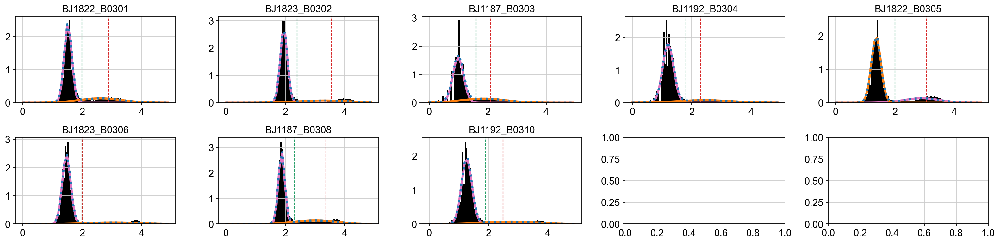

In [25]:
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(2,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]    
    if mean[0][0] < mean[1][0]:
        hashBoundry = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
    else:
        hashBoundry = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]
    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [26]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs

BJ1822_B0301
2.0
BJ1823_B0302
2.4000000000000004
BJ1187_B0303
1.6
BJ1192_B0304
1.8
BJ1822_B0305
2.0
BJ1823_B0306
2.0
BJ1187_B0308
2.3000000000000003
BJ1192_B0310
1.9000000000000001


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/416796475.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False  True ... False  True False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/416796475.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/416796475.py:6: FutureWarning: Setting an item of incompatible dt

In [27]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [28]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
doublet         7150
BJ1187_B0308    3605
BJ1822_B0301    3376
BJ1822_B0305    3326
BJ1187_B0303    3180
BJ1823_B0302    2328
BJ1192_B0304    2282
BJ1192_B0310    2013
negative        1712
BJ1823_B0306    1647
Name: count, dtype: int64

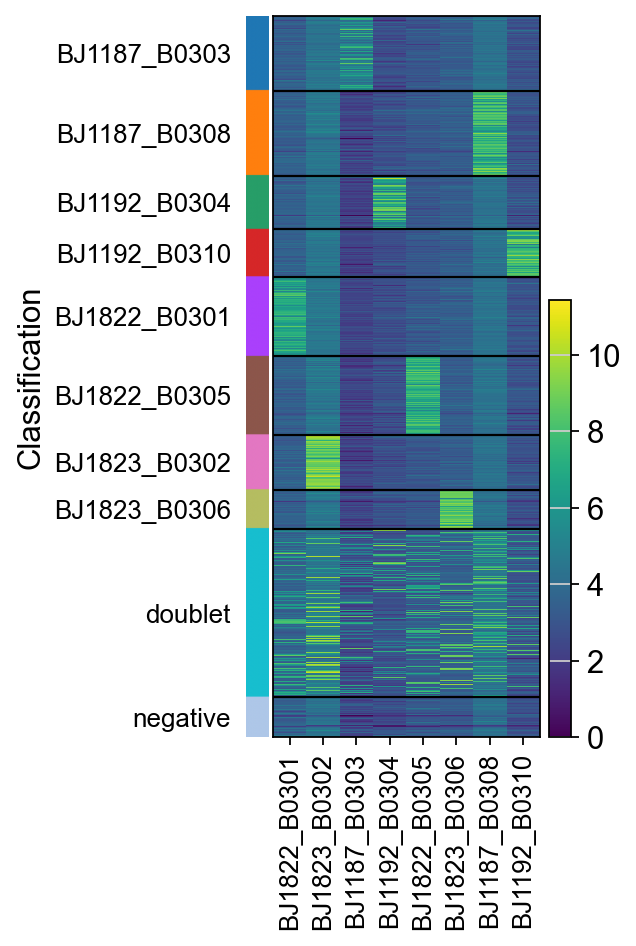

In [29]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## set highly variable genes before moving all mean to 0

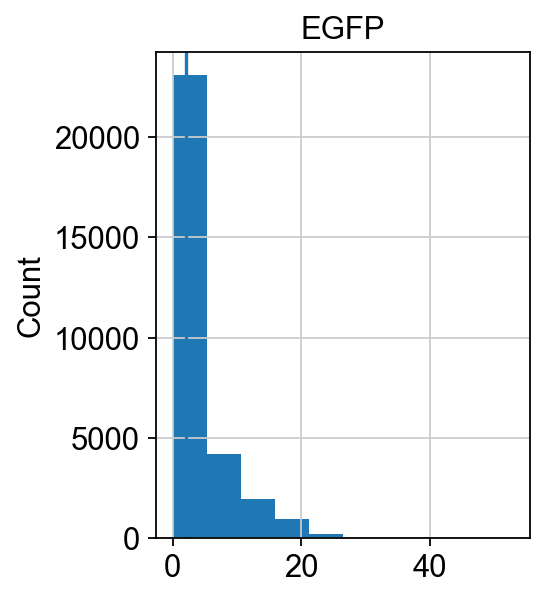

In [30]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['EGFP'])].toarray())
plt.ylabel("Count")
plt.title("EGFP")
plt.axvline(x=2)
plt.show()

In [31]:
adata.obs['EGFP_count'] = adata.X[:,adata.var.index.isin(['EGFP'])].toarray()

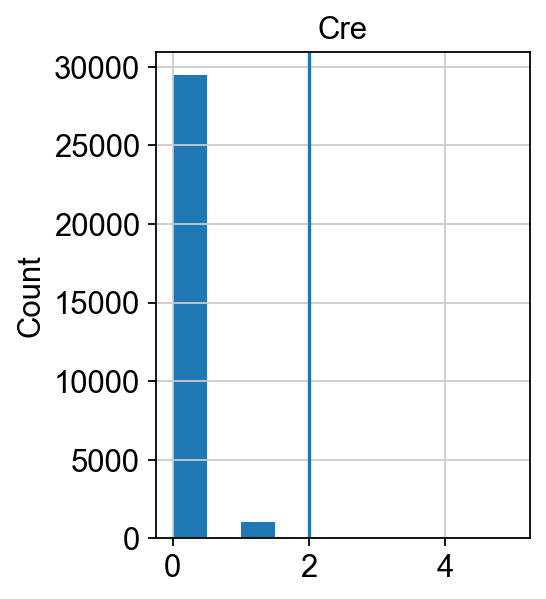

In [32]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Cre'])].toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [33]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

In [34]:
adata.var.index[-20:]

Index(['AC132444.1', 'Csprs', 'AC132444.6', 'AC125149.3', 'AC125149.2',
       'AC168977.1', 'AC149090.1', 'CAAA01118383.1', 'CAAA01098150.1',
       'CAAA01147332.1', 'EGFP', 'mScarlet', 'Cre', 'ERT', 'iDTR', 'mKate2',
       'Akaluc', 'GLuc', 'CLuc', 'tagBFP'],
      dtype='object')

## Filter doublets and negative cells

In [35]:
adata.obs.Classification.value_counts()

Classification
doublet         7150
BJ1187_B0308    3605
BJ1822_B0301    3376
BJ1822_B0305    3326
BJ1187_B0303    3180
BJ1823_B0302    2328
BJ1192_B0304    2282
BJ1192_B0310    2013
negative        1712
BJ1823_B0306    1647
Name: count, dtype: int64

In [36]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]

In [37]:
adata.obs.Classification.value_counts()

Classification
BJ1187_B0308    3605
BJ1822_B0301    3376
BJ1822_B0305    3326
BJ1187_B0303    3180
BJ1823_B0302    2328
BJ1192_B0304    2282
BJ1192_B0310    2013
BJ1823_B0306    1647
Name: count, dtype: int64

## Set Groups

In [38]:
samples

['BJ1822_B0301',
 'BJ1823_B0302',
 'BJ1187_B0303',
 'BJ1192_B0304',
 'BJ1822_B0305',
 'BJ1823_B0306',
 'BJ1187_B0308',
 'BJ1192_B0310']

In [39]:
#Set groups
adata.obs['Reporter'] = None
adata.obs['Group'] = None
adata.obs['Reporter'][adata.obs.Classification.isin(['BJ1822_B0301','BJ1823_B0302','BJ1822_B0305','BJ1823_B0306'])] = 'Hopx'
#adata.obs['Reporter'][adata.obs.Classification.isin(['BJ1187_B0303','BJ1192_B0304','BJ1187_B0308','BJ1192_B0310'])] = 'Slc4a11'
adata.obs['Group'][adata.obs.Classification.isin(['BJ1822_B0301','BJ1823_B0302'])] = 'Hopx_GFP+mScarlet+'
#adata.obs['Group'][adata.obs.Classification.isin(['BJ1187_B0303','BJ1192_B0304'])] = 'EpCAM+mScarlet+'
adata.obs['Group'][adata.obs.Classification.isin(['BJ1822_B0305','BJ1823_B0306'])] = 'Hopx_GFP+mScarlet-'
#adata.obs['Group'][adata.obs.Classification.isin(['BJ1187_B0308','BJ1192_B0310'])] = 'EpCAM+mScarlet-'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4038586764.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Reporter'] = None
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4038586764.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https:/

In [40]:
adata = adata[adata.obs['Reporter'].isin(['Hopx']),:]

In [41]:
adata.layers['counts']=adata.X.copy()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/1857676282.py:1: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  adata.layers['counts']=adata.X.copy()


In [42]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [43]:
sc.pp.log1p(adata)

In [44]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


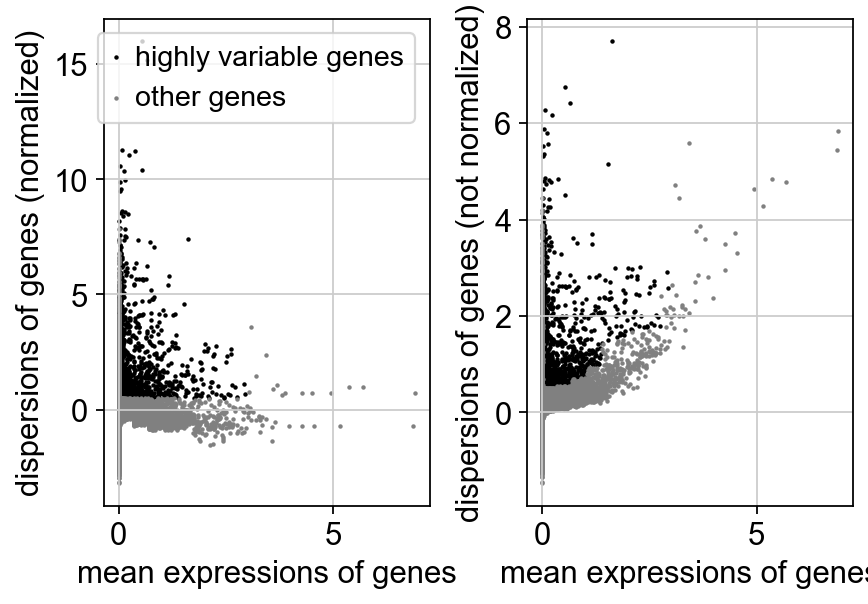

In [45]:
sc.pl.highly_variable_genes(adata)

In [46]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/850513103.p

In [47]:
adata.raw = adata

In [48]:
adata.write('write/allmice-IGO16318.h5ad', compression='gzip')

In [49]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [50]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


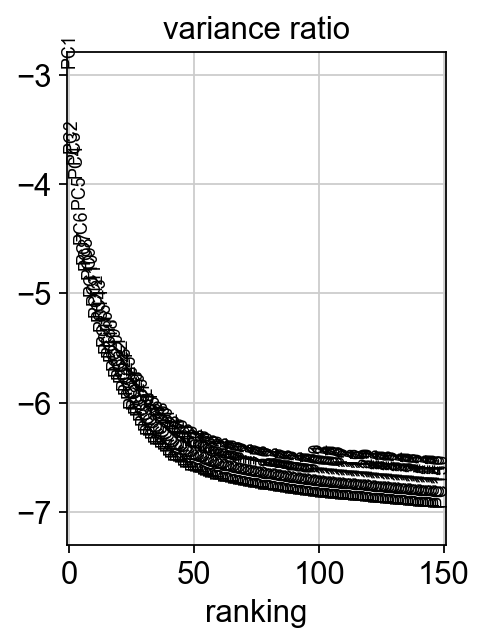

In [51]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [52]:
adata.write(results_file, compression='gzip')

## Computing the neighborhood graph

In [53]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=80)

computing neighbors
    using 'X_pca' with n_pcs = 80
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:23)


## Embedding the neighborhood graph

In [54]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)


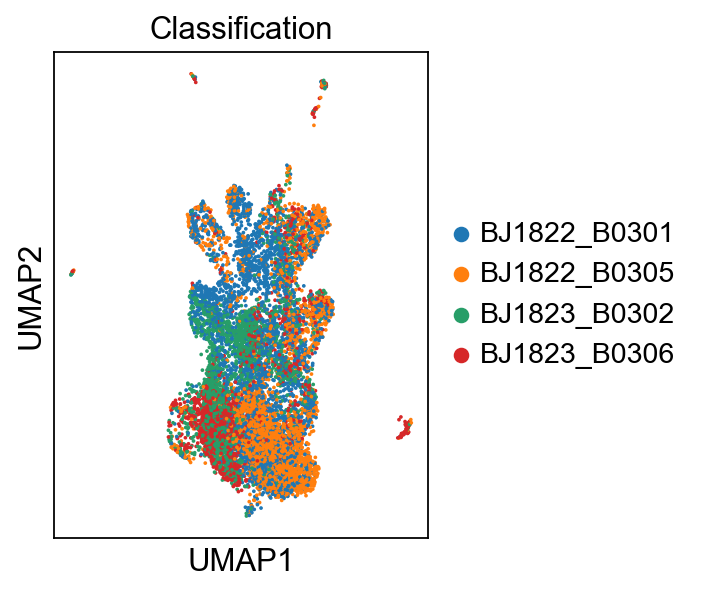

In [55]:
sc.pl.umap(adata, color=['Classification'])

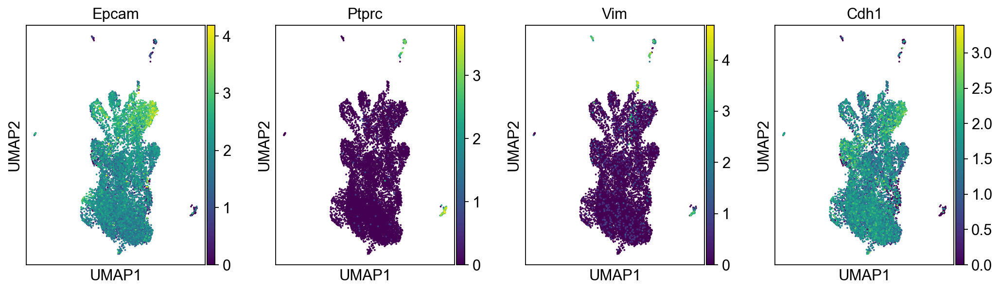

In [56]:
sc.pl.umap(adata, color=['Epcam','Ptprc','Vim', 'Cdh1',]) #'Ptprc','Cdh2'

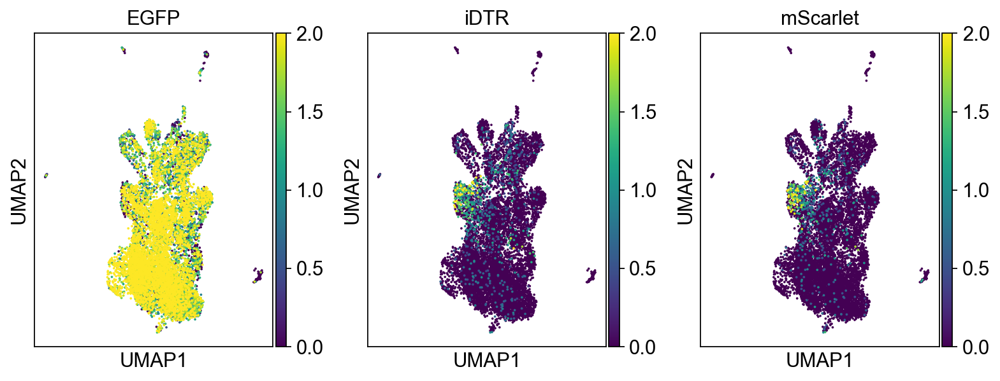

In [57]:
sc.pl.umap(adata, color=['EGFP','iDTR','mScarlet'], vmax=2)

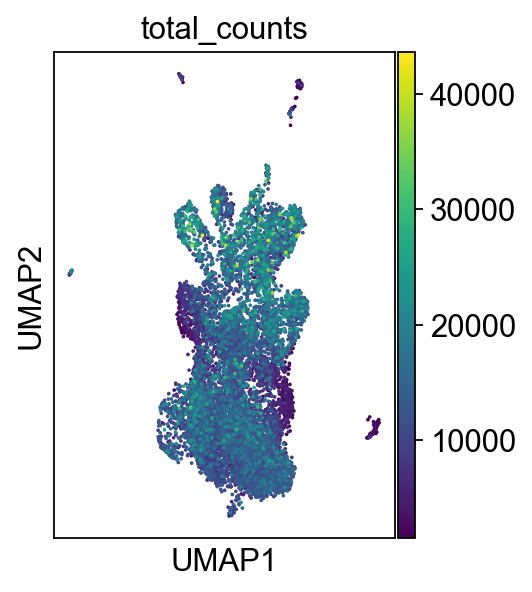

In [58]:
sc.pl.umap(adata, color=['total_counts'])

## Define scoring Functions

In [59]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [60]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [61]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1493 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1096 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1290 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1397 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1591 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Gm6139'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1697 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.

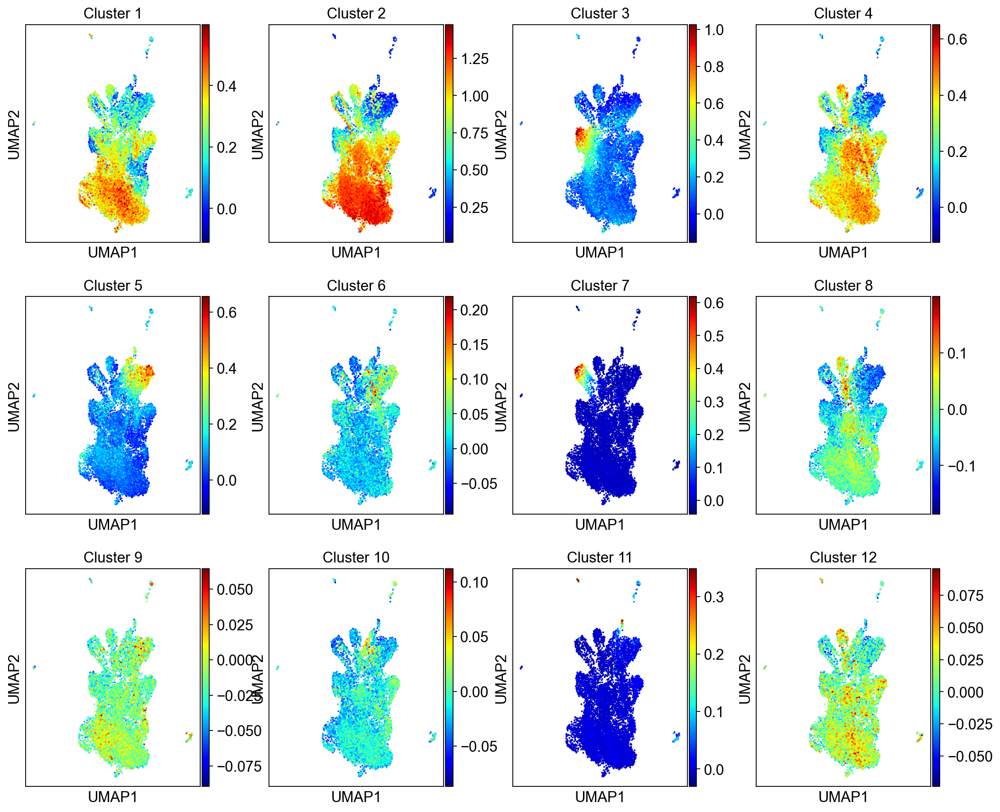

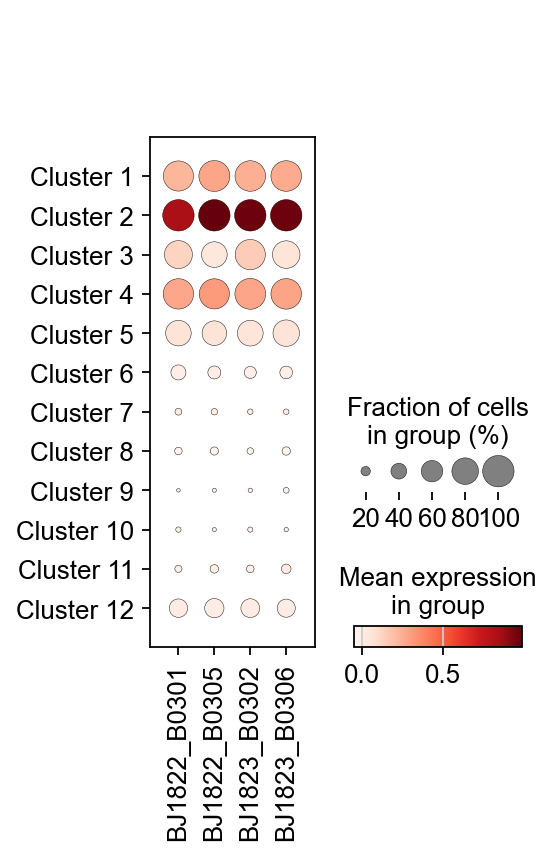

In [62]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [63]:
sc.tl.leiden(adata, resolution=0.2)

running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4124055652.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2)


    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

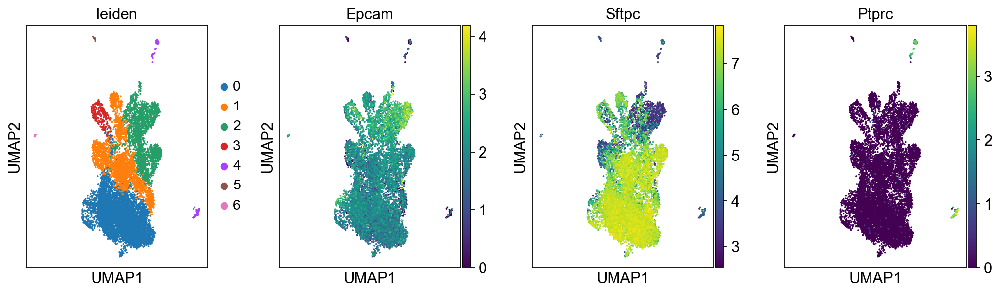

(None,)

In [64]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

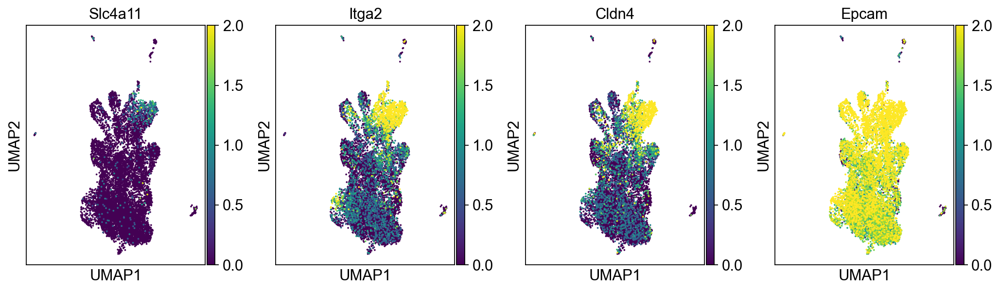

In [65]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

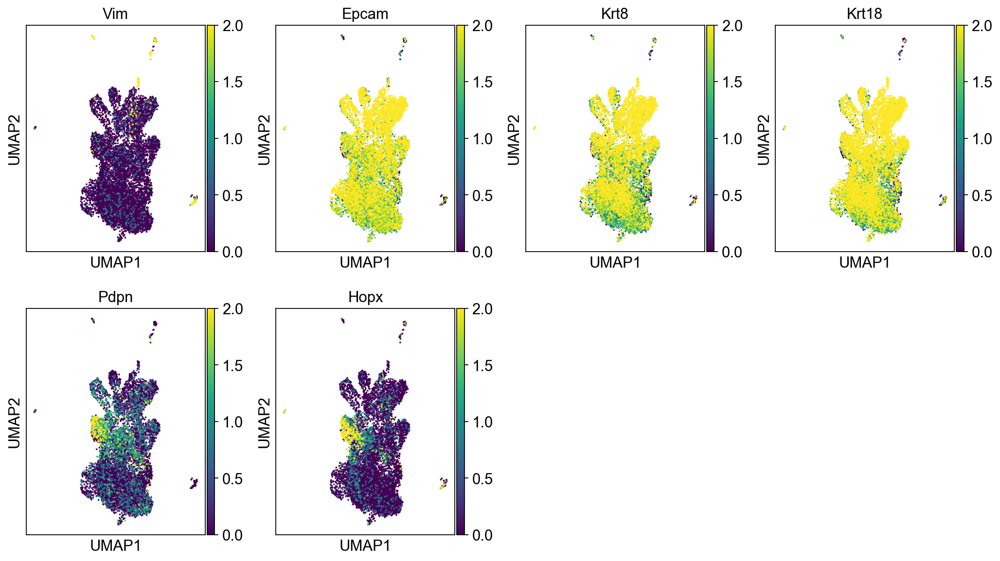

In [66]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

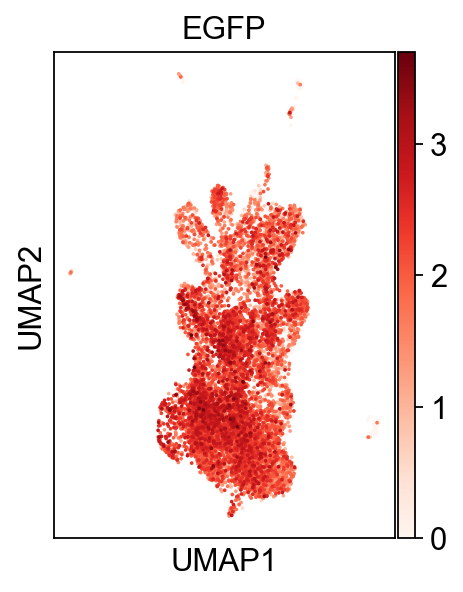

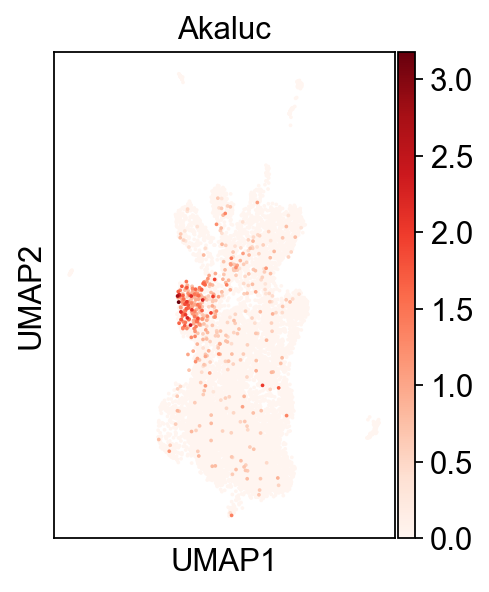

In [67]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
#sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')
sc.pl.umap(adata, color=['Akaluc'], cmap='Reds')

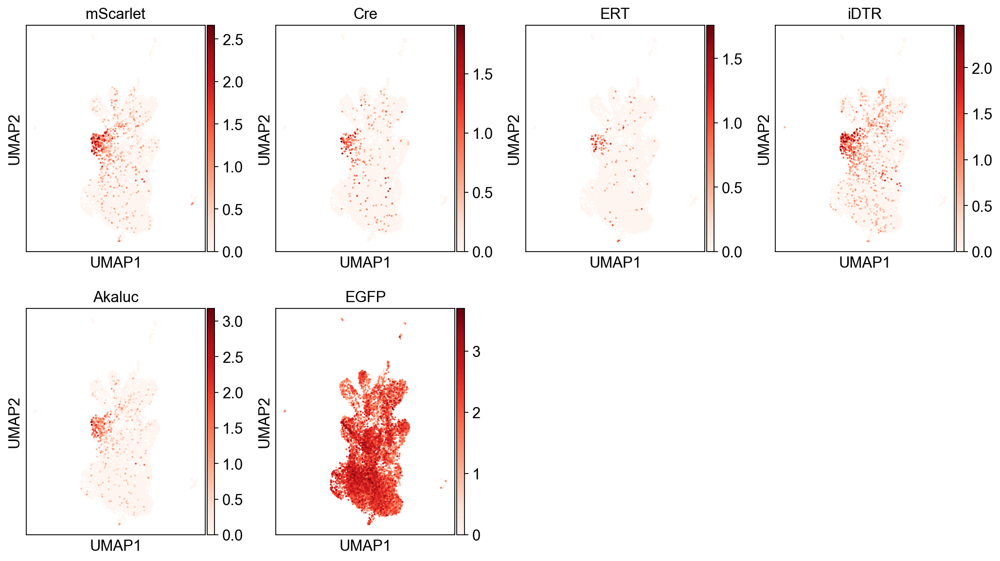

In [68]:
sc.pl.umap(adata, color=["mScarlet", "Cre", "ERT",'iDTR','Akaluc','EGFP'], cmap='Reds') #'mKate2'

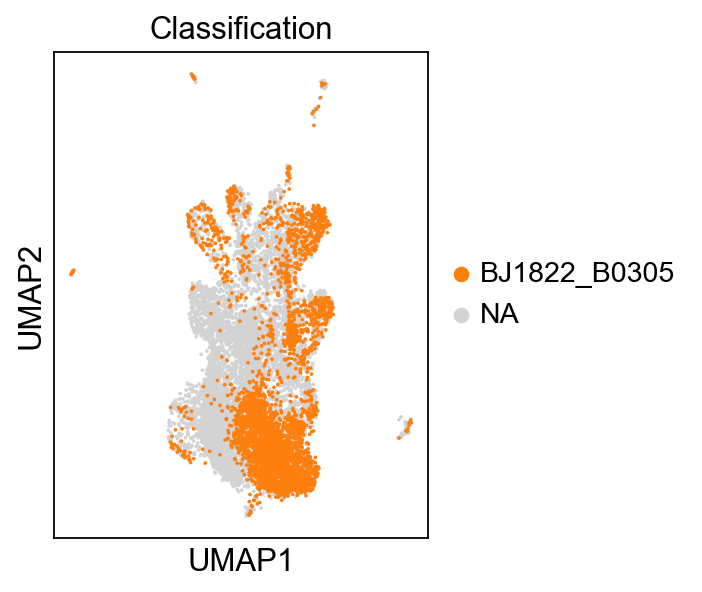

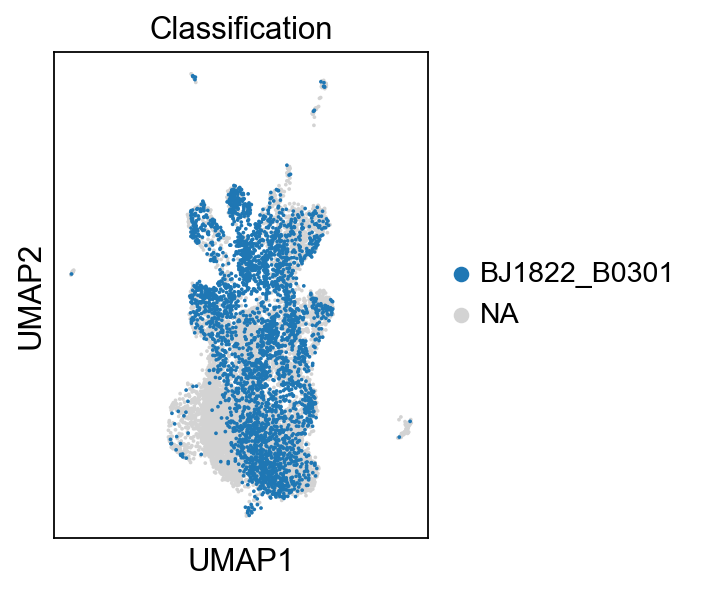

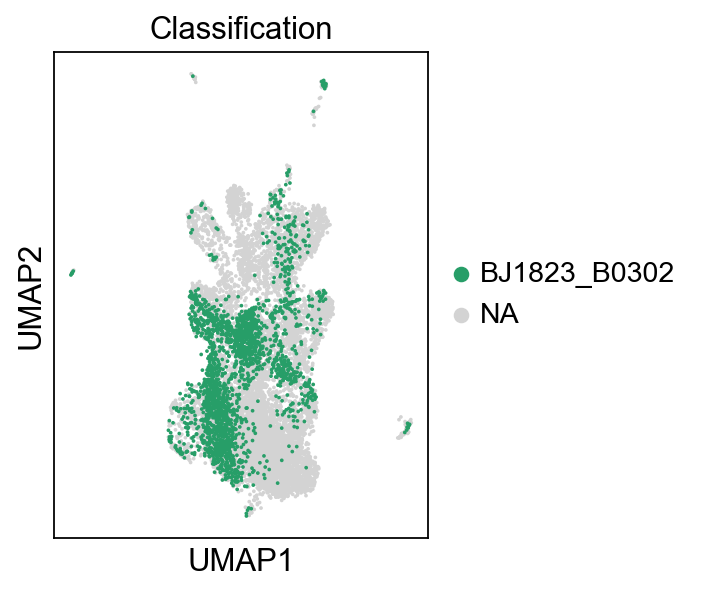

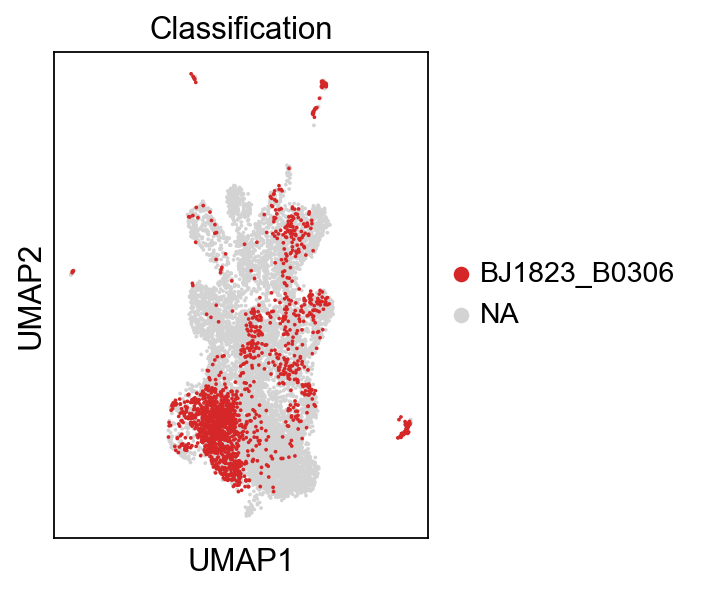

In [69]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

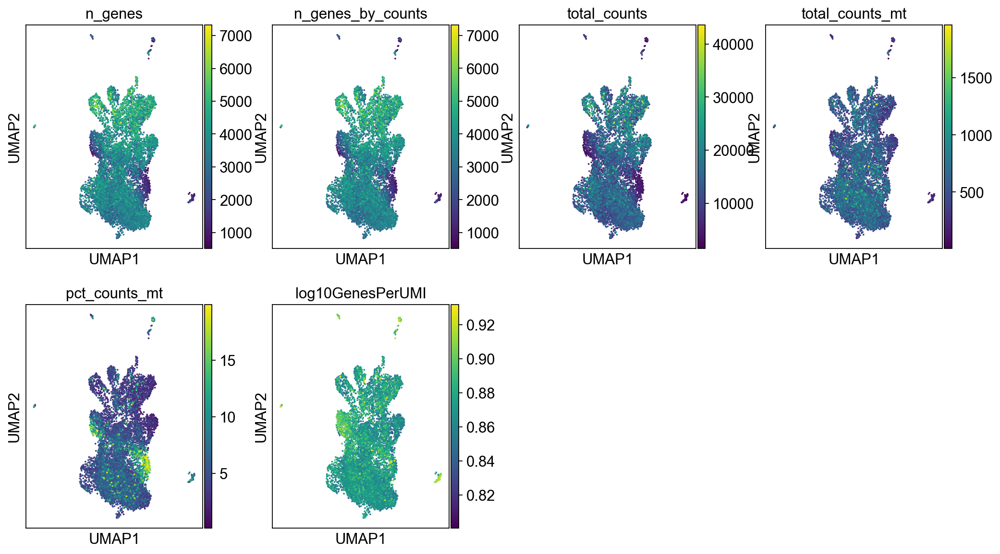

In [70]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

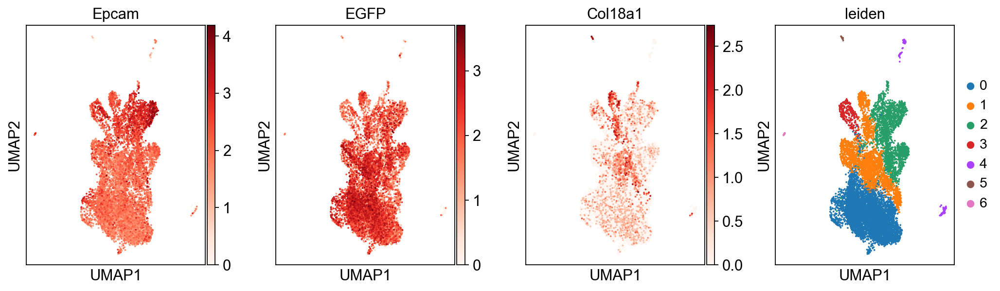

In [71]:
sc.pl.umap(adata, color=['Epcam','EGFP','Col18a1','leiden',],cmap="Reds")

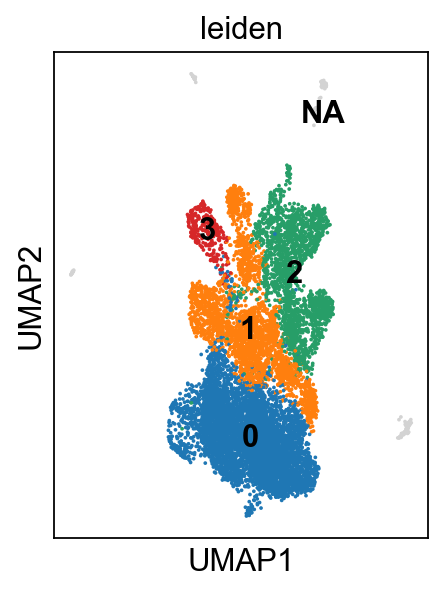

In [72]:
sc.pl.umap(adata, color=['leiden'], groups=['0','1','2','3'],legend_loc='on data')

## Select Tumor Cells

In [73]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-IGO16318.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','1','2','3']),:] # keep tumor cells
del adata2

In [74]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [75]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [76]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/850513103.p

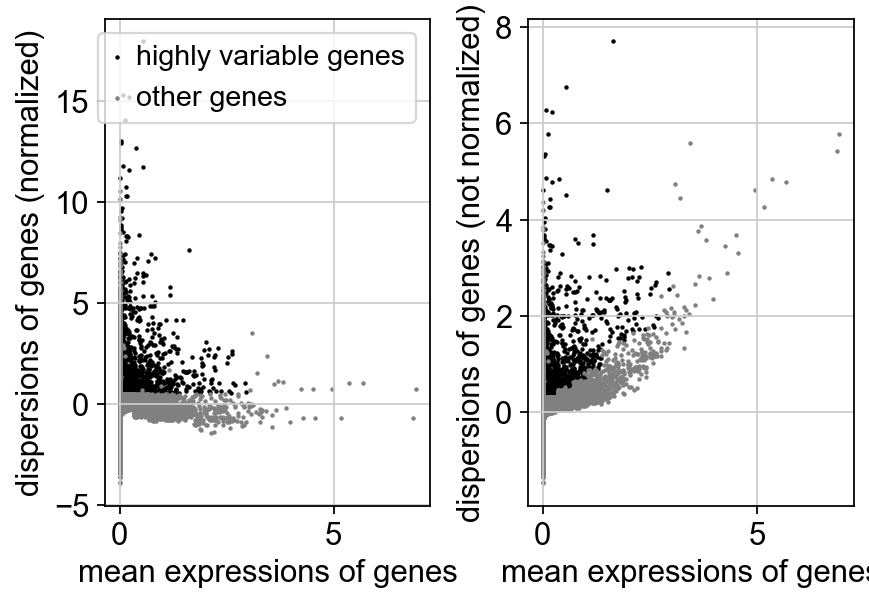

In [77]:
sc.pl.highly_variable_genes(adata)

In [78]:
adata.raw = adata

In [79]:
adata.write('write/allmice-tumor-IGO16318.h5ad', compression='gzip')
#adata = sc.read('write/allmice-tumor.h5ad')

## Now rerun algorithm

In [80]:
adata.obs.Classification.value_counts()

Classification
BJ1822_B0301    3361
BJ1822_B0305    3289
BJ1823_B0302    2300
BJ1823_B0306    1557
Name: count, dtype: int64

In [81]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [82]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


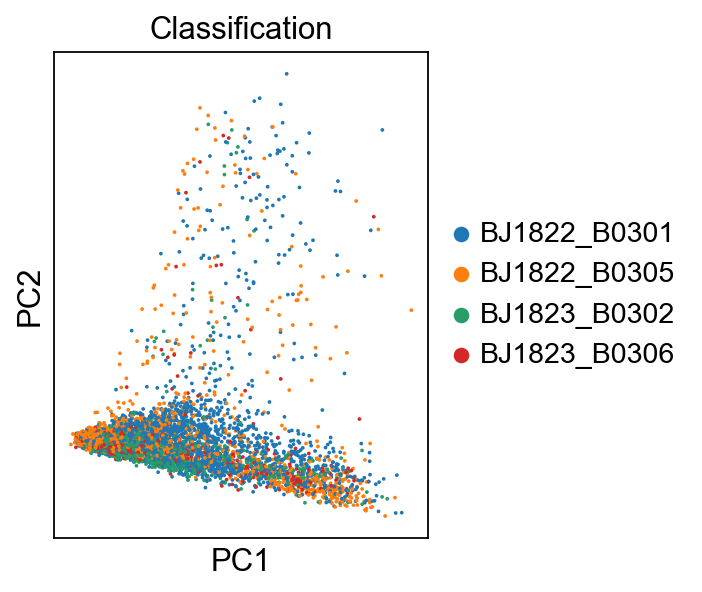

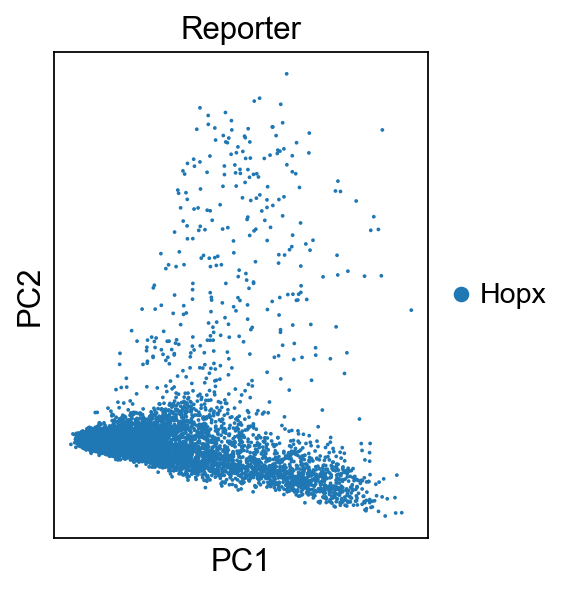

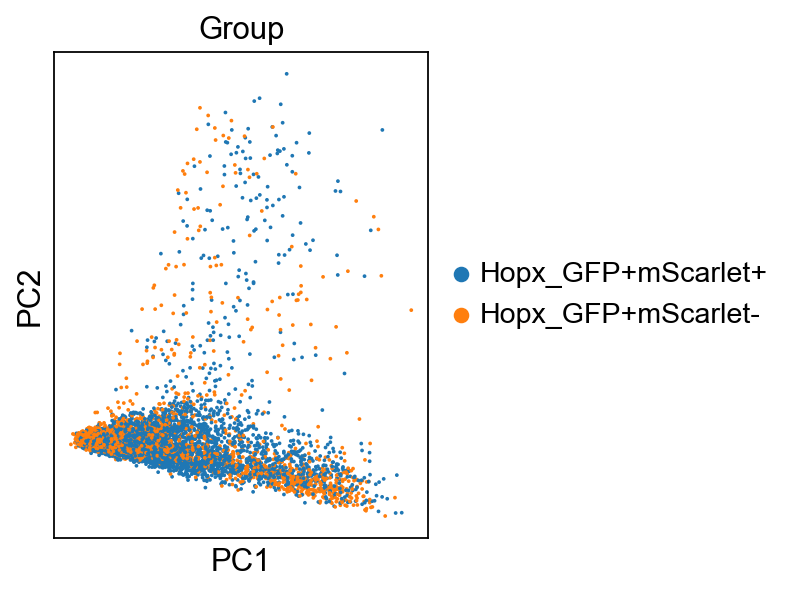

In [83]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Classification',dimensions=[(0,1)])
sc.pl.pca(adata, color='Reporter',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])

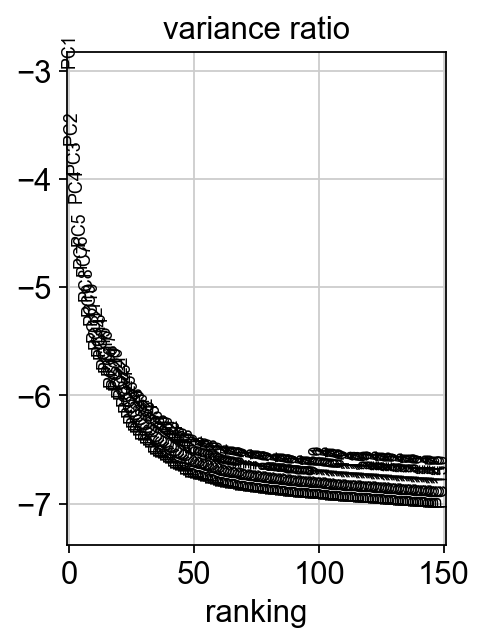

In [84]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [85]:
adata.write(results_file, compression='gzip')

## Computing the neighborhood graph

In [86]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=100)

computing neighbors
    using 'X_pca' with n_pcs = 100
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


## Embedding the neighborhood graph

In [87]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)


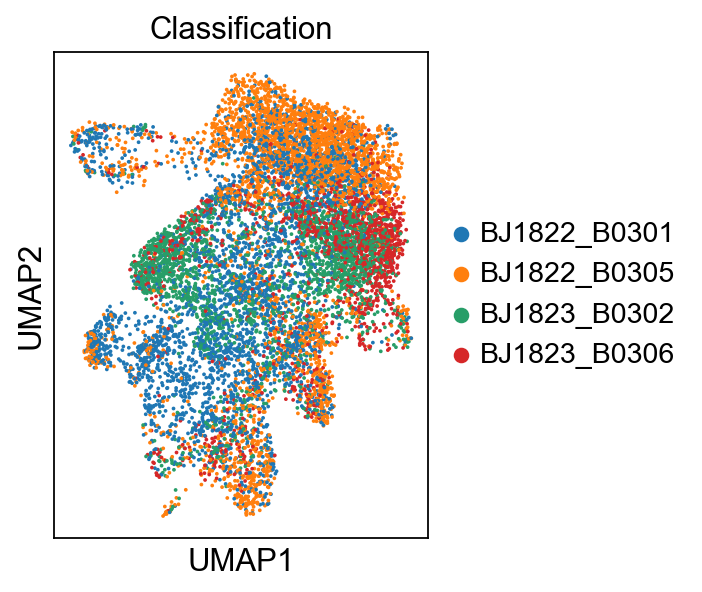

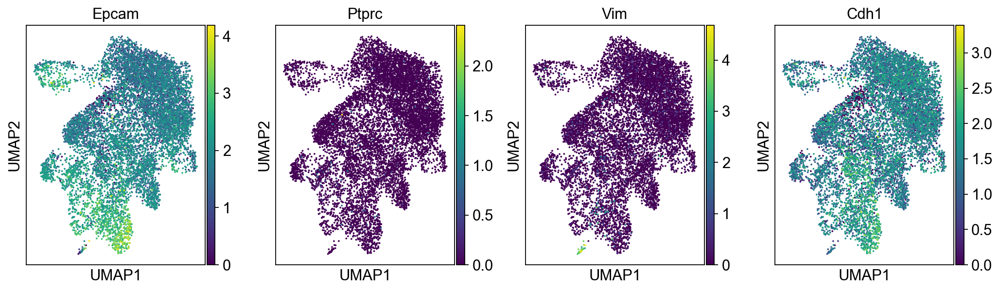

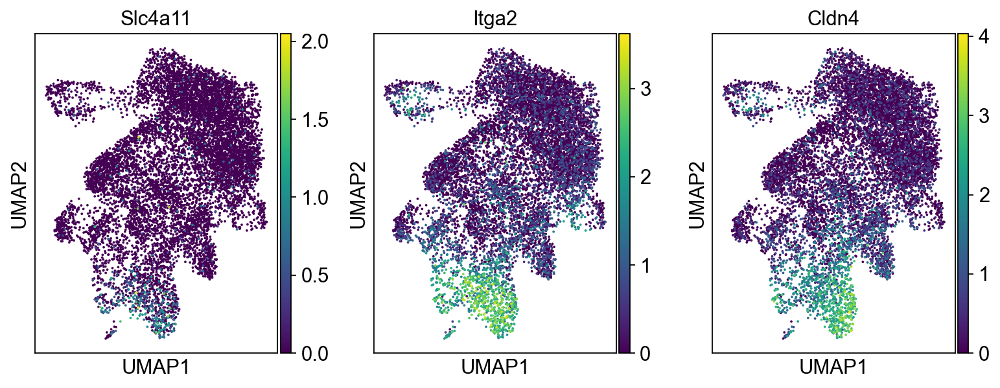

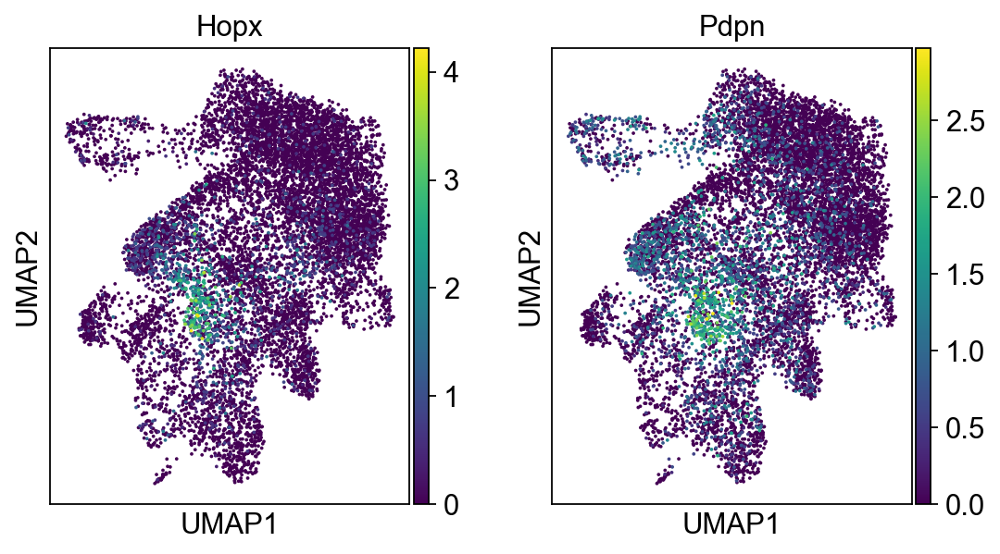

In [88]:
sc.pl.umap(adata, color=['Classification'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

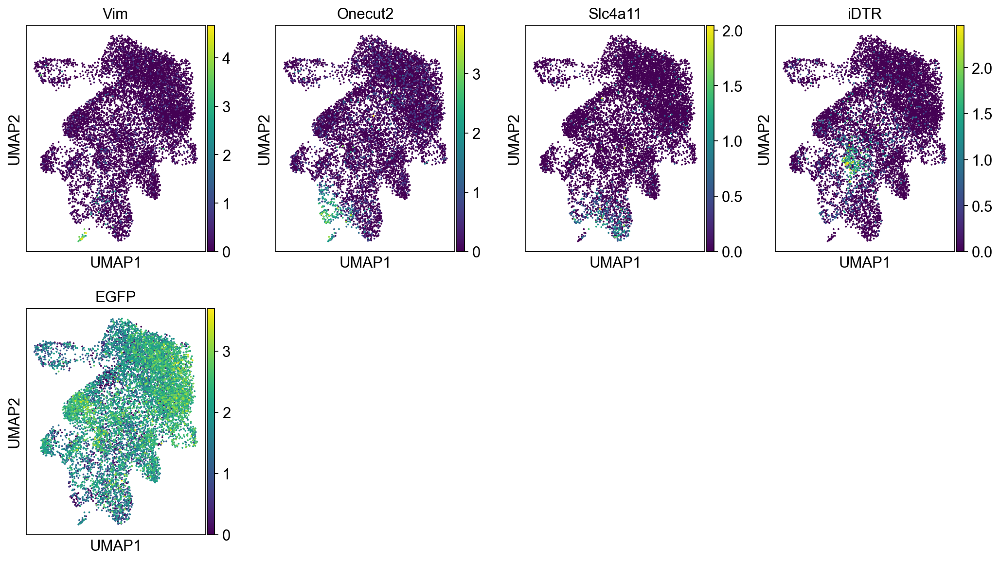

In [89]:
sc.pl.umap(adata, color=['Vim', 'Onecut2', 'Slc4a11', 'iDTR', 'EGFP']) #'Sox11', 

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1592 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1093 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1390 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1394 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1593 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Gm6139'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1796 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.

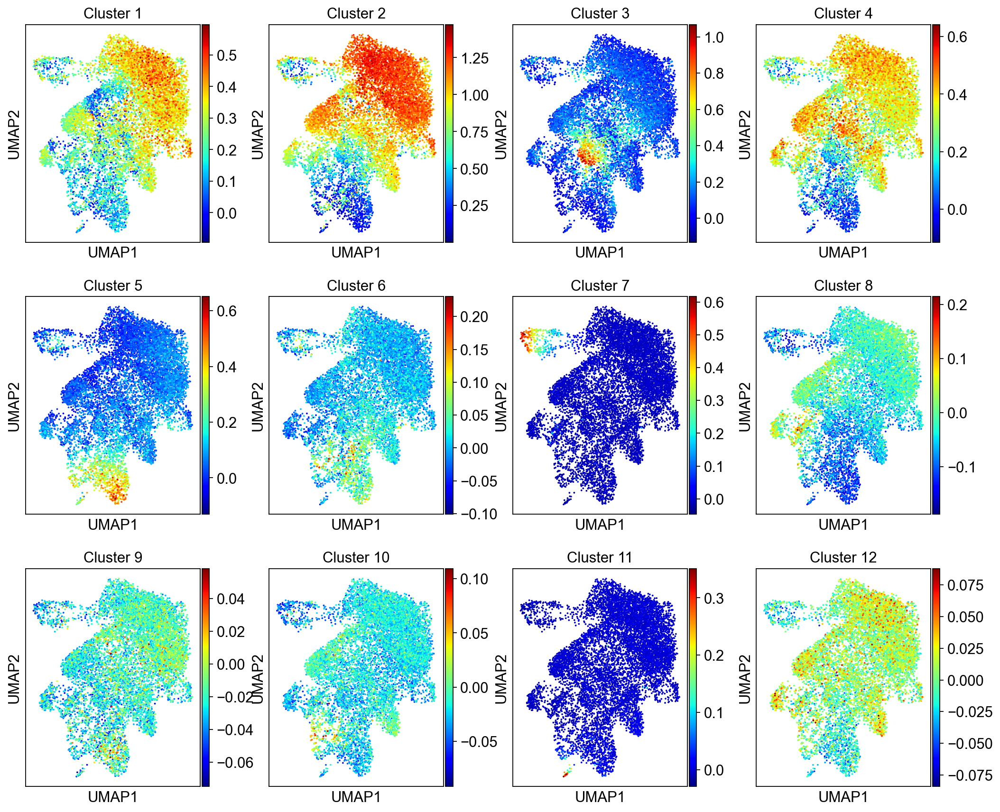

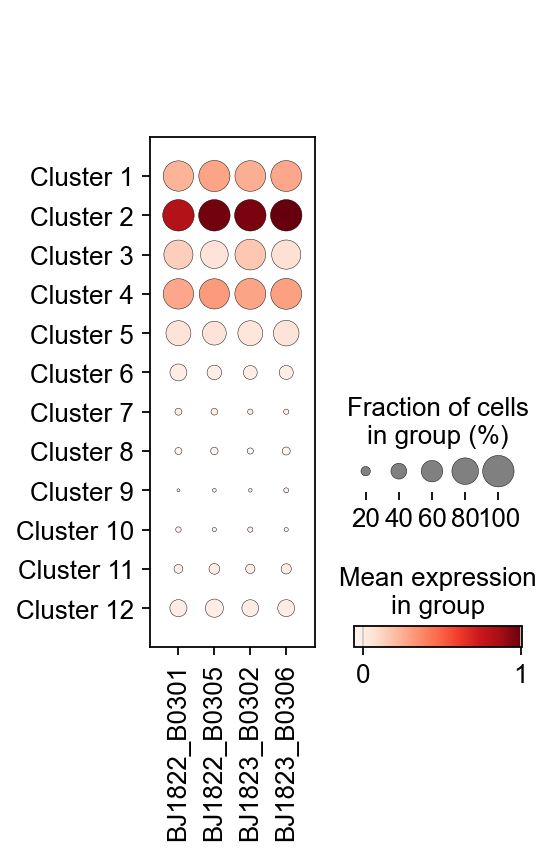

In [90]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

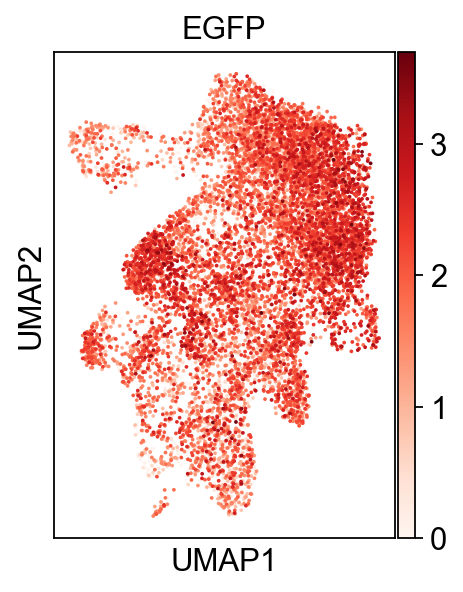

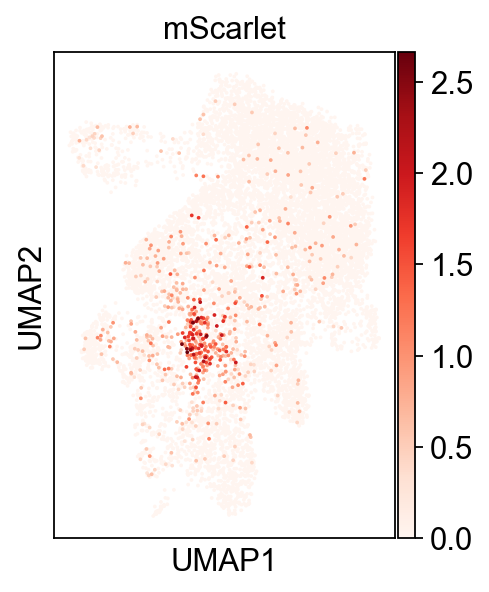

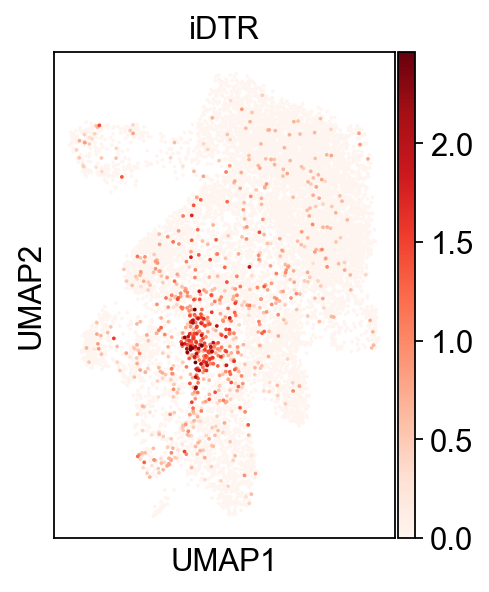

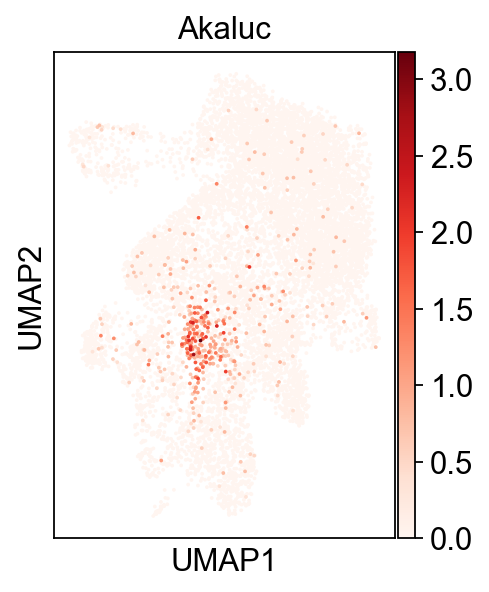

In [91]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')
sc.pl.umap(adata, color=['Akaluc'], cmap='Reds')
#sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')

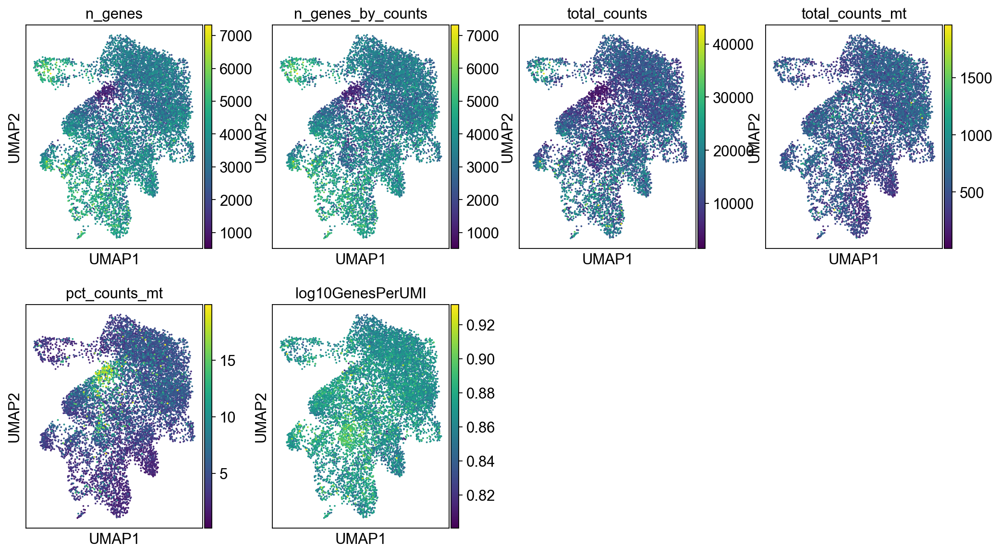

In [92]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [93]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


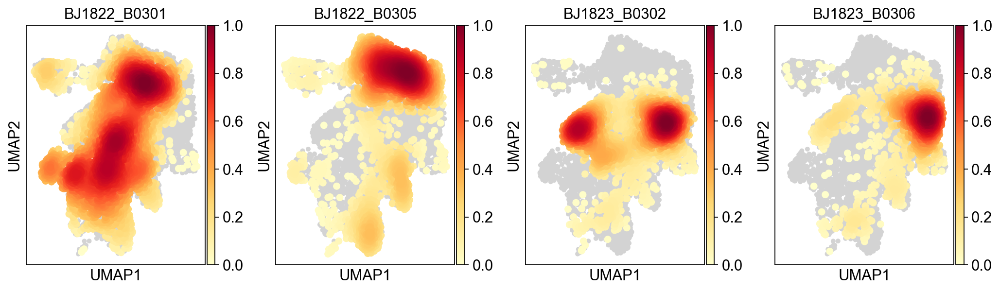

In [94]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


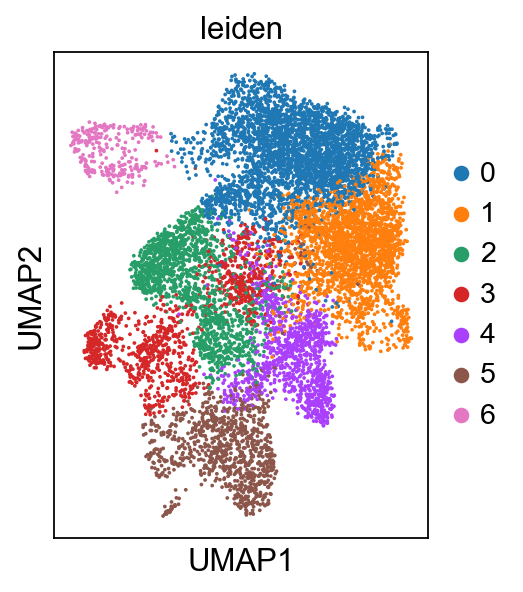

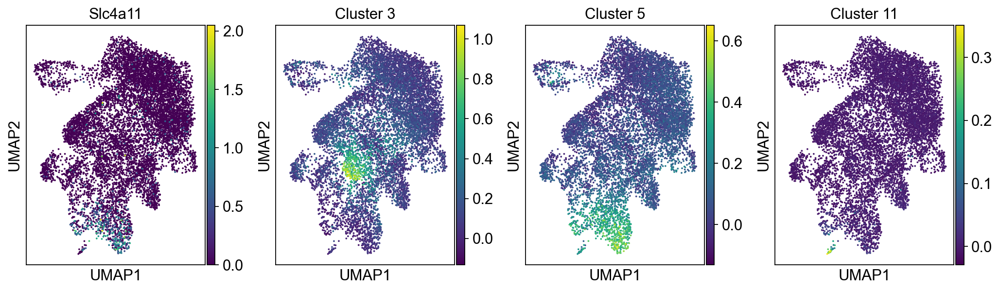

In [95]:
sc.tl.leiden(adata, resolution=.35)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Slc4a11','Cluster 3','Cluster 5','Cluster 11'])

In [96]:
adata.obs[['Classification']].value_counts(sort=False)

Classification
BJ1822_B0301      3361
BJ1822_B0305      3289
BJ1823_B0302      2300
BJ1823_B0306      1557
Name: count, dtype: int64

## Logistic Regression

In [97]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [98]:
adata_log = adata[:,adata.var.index.isin(names)]

In [99]:
adata_names = [x for x in adata_log.var.index]

In [100]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [101]:
smartseq = anndata.read('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [102]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [103]:
names = [x for x in names_adata.var.index]

In [104]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1264: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [105]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[141,   6,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  9,  68,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 178,   1,   0,   4,   0,   1,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   3,   0,   0,   3,   0,  54,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

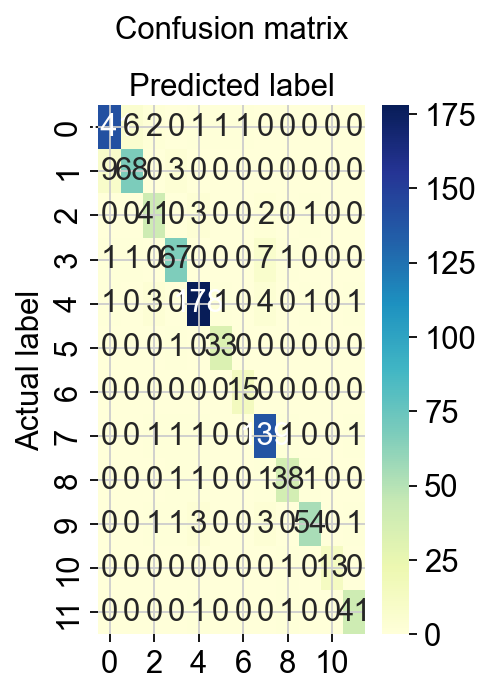

In [106]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [107]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.93      0.93       152
           2       0.91      0.85      0.88        80
           3       0.85      0.87      0.86        47
           4       0.91      0.87      0.89        77
           5       0.95      0.94      0.94       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.89      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.95      0.86      0.90        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.92      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [108]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [109]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


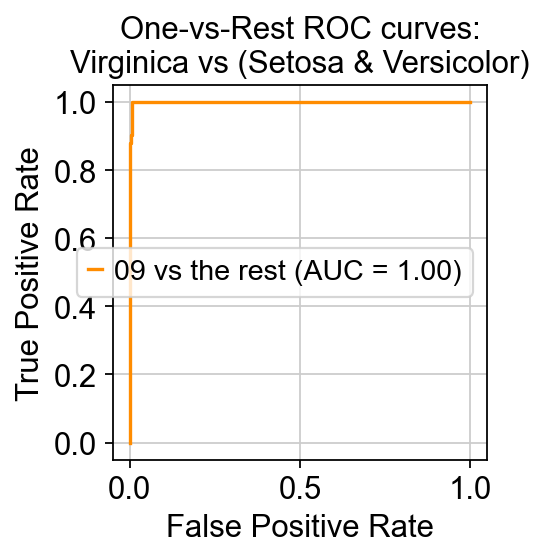

In [110]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [111]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [112]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [113]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,2.068088e-08,1.208437e-04,1.405385e-01,2.356906e-02,1.630759e-06,5.180776e-05,4.541046e-04,8.345653e-01,3.065982e-06,2.914428e-05,2.544956e-05,6.410801e-04,0.834565,0
1,01,01,9.999899e-01,2.636927e-07,1.320328e-08,9.309089e-08,1.181077e-07,1.135129e-06,8.369231e-06,3.132537e-10,2.747711e-09,7.069374e-09,1.183418e-07,8.247750e-09,0.999990,1
2,08,08,4.055106e-09,2.503479e-07,3.485463e-07,1.986836e-06,6.925887e-06,8.323519e-07,3.369463e-05,9.998965e-01,8.419086e-06,4.507580e-05,5.509637e-06,4.362959e-07,0.999897,1
3,05,10,4.288999e-08,7.205433e-06,2.577646e-05,3.824254e-07,4.994161e-01,6.473211e-04,6.975437e-05,3.657115e-05,3.398727e-04,4.984470e-01,7.372188e-05,9.362300e-04,0.499416,0
4,08,08,7.047644e-08,4.134163e-07,5.863026e-08,3.589162e-06,1.284140e-05,1.254692e-06,1.120508e-04,9.995860e-01,2.563426e-04,1.570617e-05,6.259512e-06,5.365466e-06,0.999586,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.599223e-04,1.604281e-07,3.112775e-06,3.871159e-05,9.899361e-01,4.792442e-03,3.368571e-04,2.235961e-03,7.022870e-04,1.513387e-03,1.695408e-04,1.149780e-05,0.989936,1
896,05,05,3.049031e-10,3.498560e-07,2.499110e-07,1.877176e-07,9.999849e-01,7.295240e-06,3.673402e-07,6.014595e-10,1.251817e-07,2.528667e-07,5.337484e-06,9.821783e-07,0.999985,1
897,08,08,2.351155e-06,5.871485e-05,8.084468e-06,1.269235e-02,5.134435e-08,4.276243e-06,9.069484e-05,9.858619e-01,1.090279e-03,1.472748e-04,2.022492e-05,2.381842e-05,0.985862,1
898,05,05,6.783503e-11,2.170859e-07,4.389885e-06,8.825127e-12,9.999940e-01,5.621219e-08,2.996019e-07,4.622677e-07,6.707800e-08,7.172496e-08,3.481743e-07,1.137454e-07,0.999994,1


In [114]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.36-0.87,0.356263,0.871471,0.612403
1,0.87-0.98,0.871471,0.981222,0.898438
2,0.98-1.0,0.981222,0.996550,0.945736
3,1.0-1.0,0.999021,0.999881,0.996109


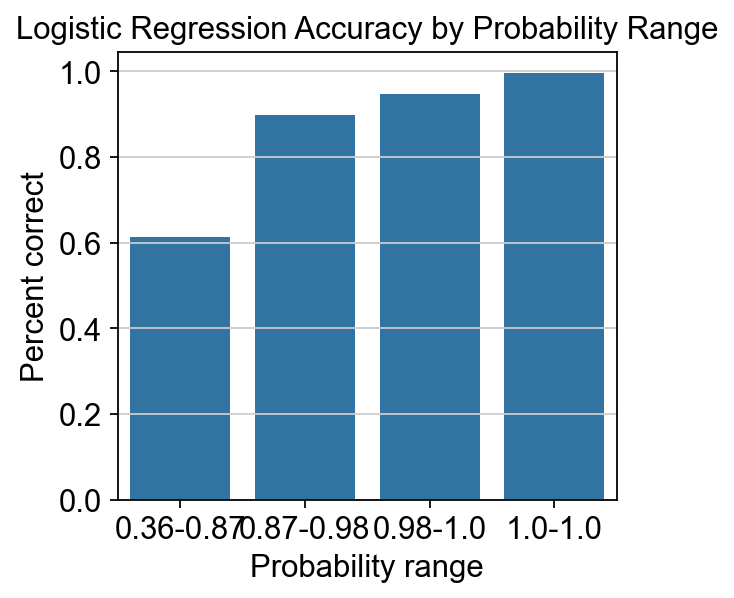

In [115]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [116]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

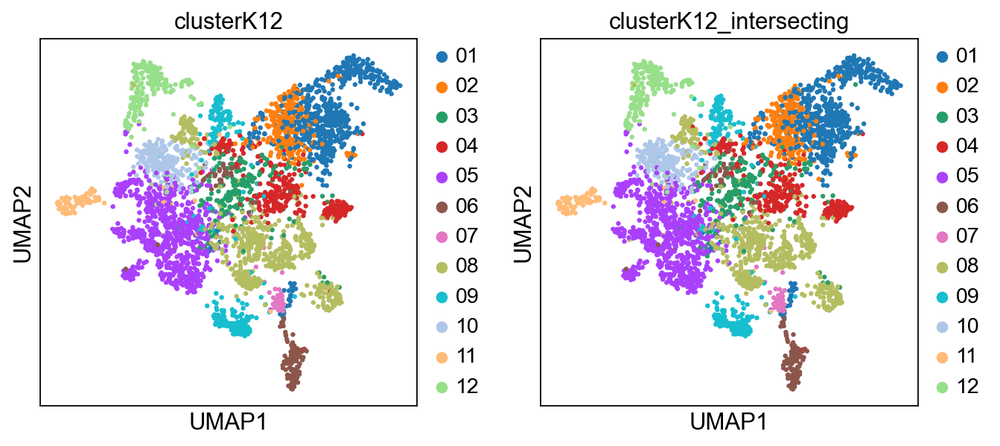

In [117]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [118]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [119]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.98

In [120]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.343406e-12,1.489275e-10,1.101826e-10,3.165359e-13,1.271708e-08,3.182880e-11,4.769510e-09,1.050687e-11,2.099719e-10,9.474723e-11,1.000000e+00,1.399676e-09,1.000000
1,12,2.259078e-10,2.739192e-11,9.606558e-11,2.680336e-09,2.639313e-09,1.061239e-06,1.788671e-08,4.177114e-08,1.052779e-07,4.644340e-07,9.867909e-09,9.999983e-01,0.999998
2,05,8.755021e-04,2.243269e-07,3.431594e-04,1.571574e-07,9.987578e-01,1.763091e-05,6.868571e-07,1.115788e-10,2.746399e-07,9.653760e-07,8.798948e-07,2.716080e-06,0.998758
3,10,4.898526e-07,3.896390e-07,4.585701e-07,1.795798e-03,6.767472e-07,8.750112e-06,7.086290e-06,2.374440e-03,8.647987e-06,9.957820e-01,4.223850e-06,1.701579e-05,0.995782
4,01,9.999965e-01,5.452645e-09,1.430558e-06,1.592371e-06,9.965036e-09,1.016314e-07,7.088661e-08,2.031698e-10,1.775248e-10,7.375751e-09,3.140055e-07,1.733929e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,3.100924e-10,9.283322e-08,7.059214e-09,1.396041e-07,1.317508e-08,7.326029e-09,5.771844e-07,9.999957e-01,3.206040e-06,1.493378e-07,5.968360e-08,9.734235e-09,0.999996
3596,09,8.349722e-08,2.597216e-07,1.190661e-07,8.227072e-08,1.183310e-06,5.308806e-08,1.316330e-06,3.895268e-04,9.996037e-01,2.455513e-07,3.311840e-06,1.090808e-07,0.999604
3597,08,3.629056e-08,4.031582e-06,8.395488e-08,4.376108e-05,2.506736e-08,5.604353e-08,7.169070e-06,9.998448e-01,9.412237e-05,2.806133e-06,2.208870e-06,9.091313e-07,0.999845
3598,08,7.857186e-09,2.155733e-06,2.800243e-06,1.703206e-06,4.041453e-04,2.071739e-07,1.013162e-05,9.995489e-01,9.222122e-06,1.473313e-05,4.123021e-06,1.902095e-06,0.999549


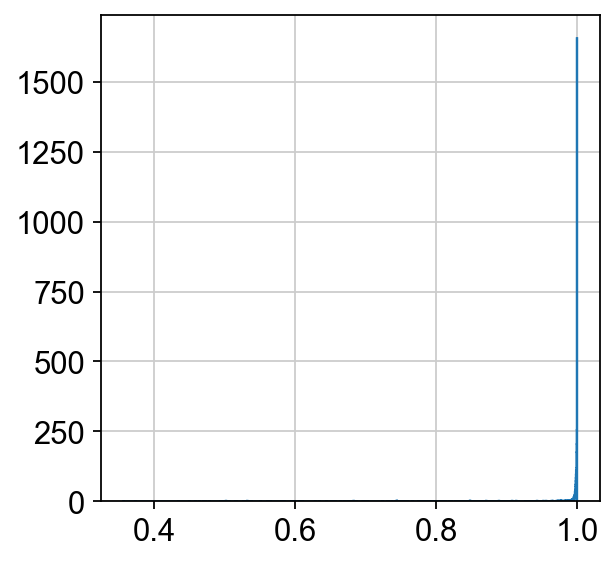

In [121]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Verify LogisticRegression

In [122]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [123]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [124]:
y_pred = logreg.predict(adata_log_ordered.X)

In [125]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [126]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

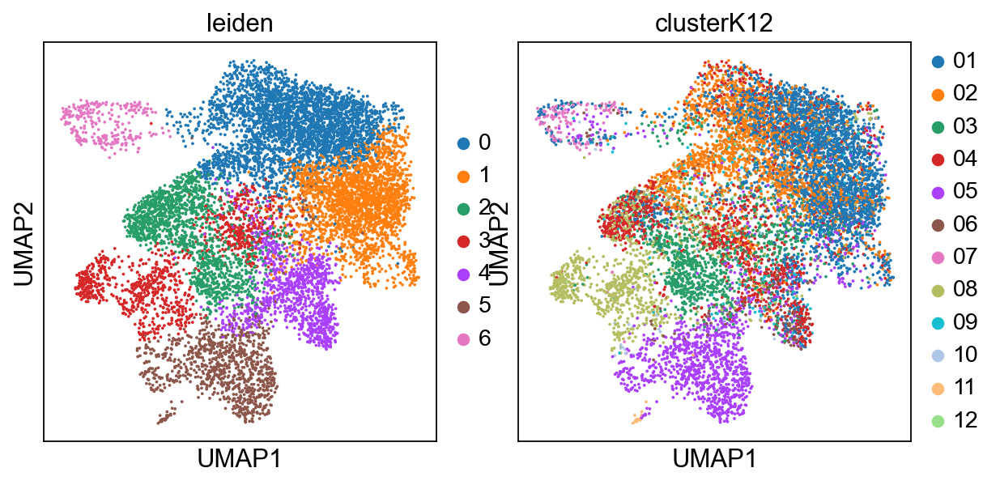

In [127]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

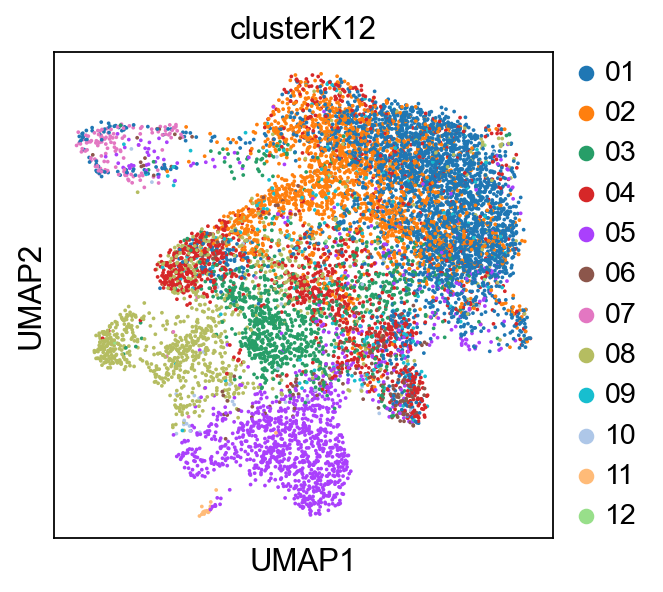

In [128]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

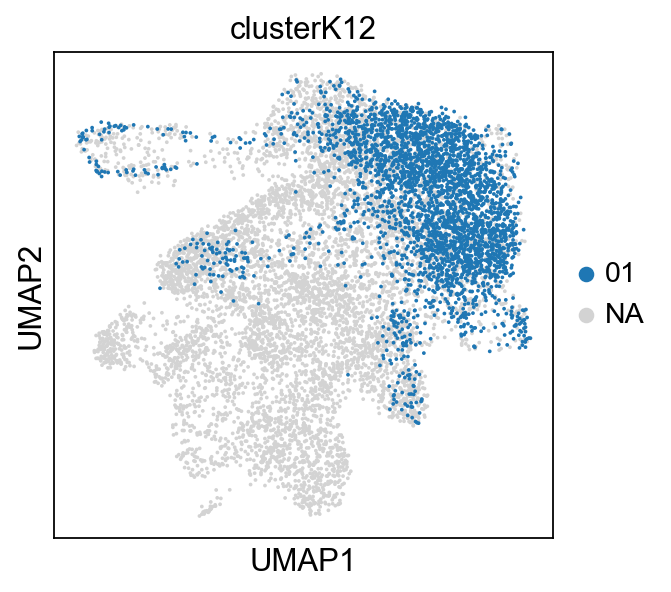

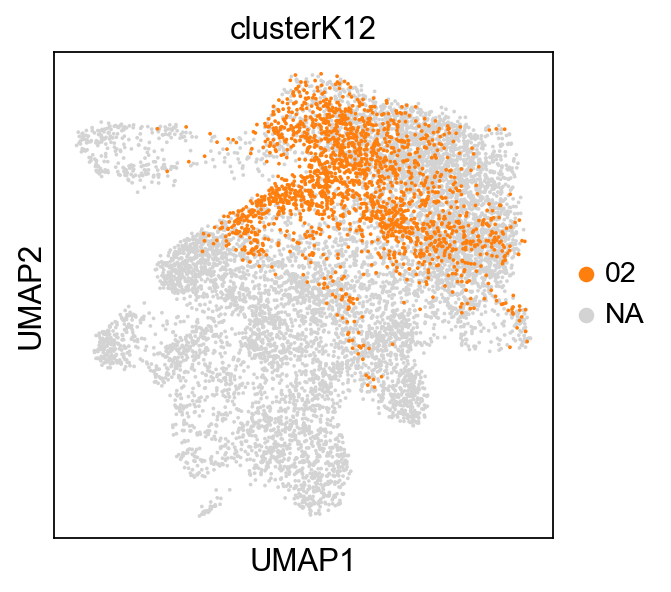

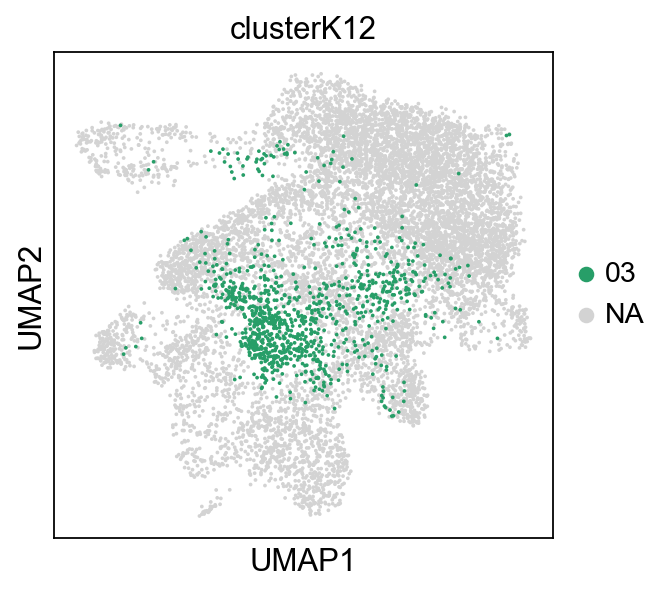

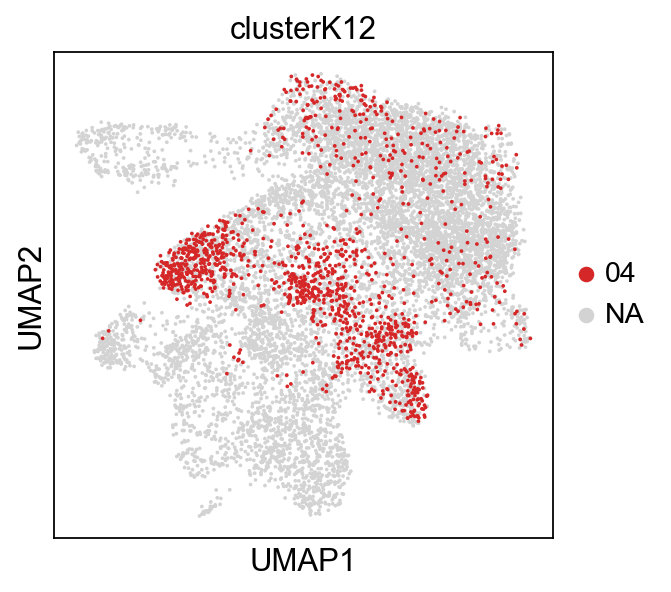

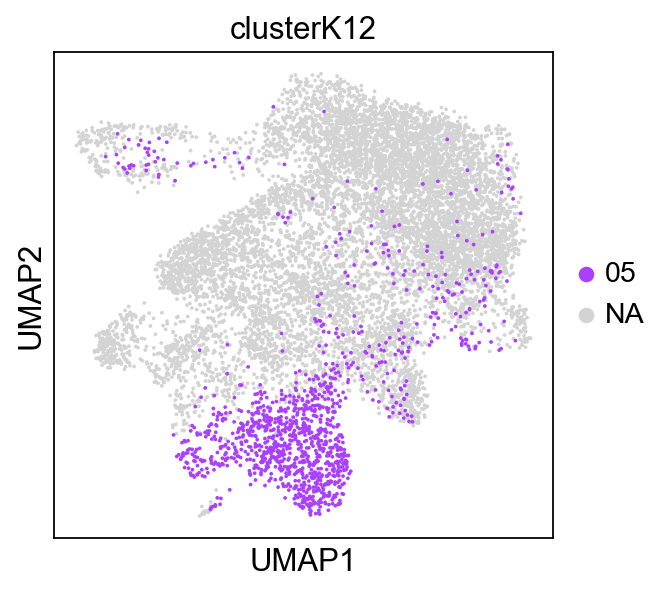

...

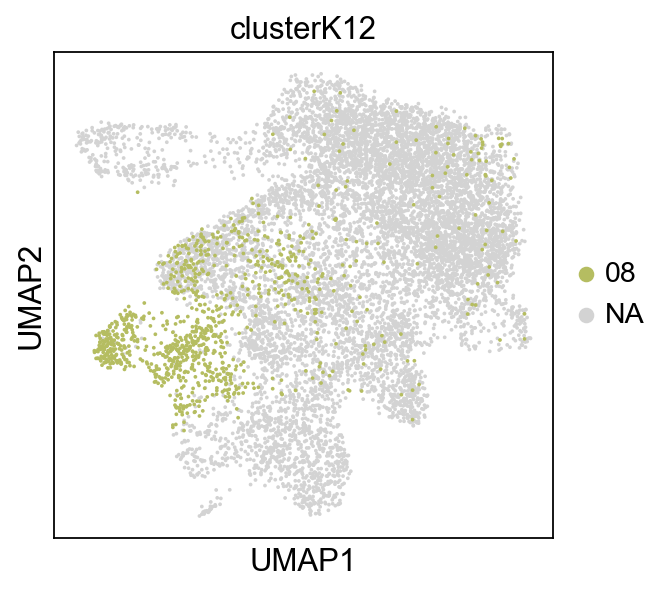

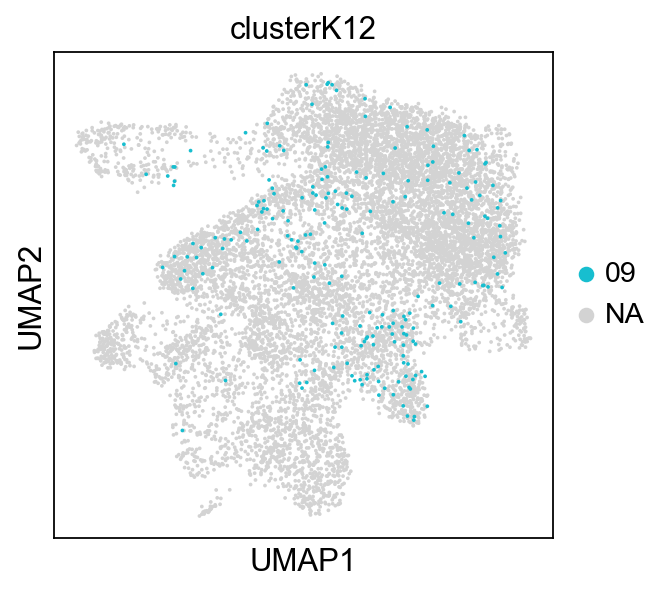

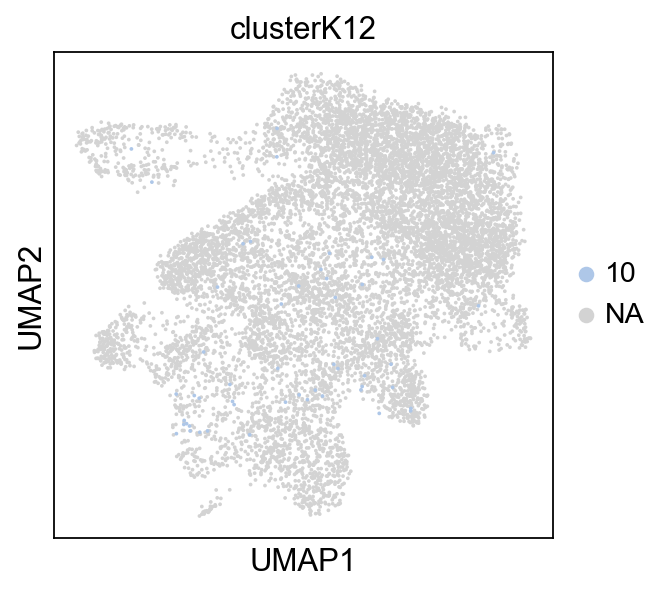

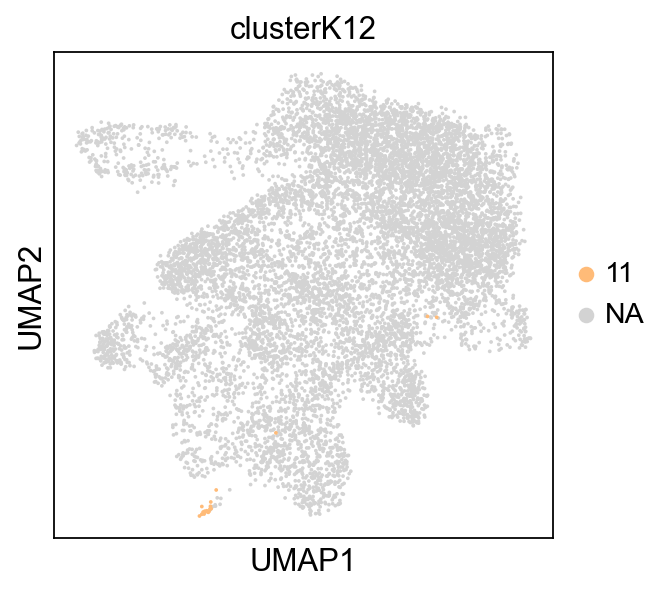

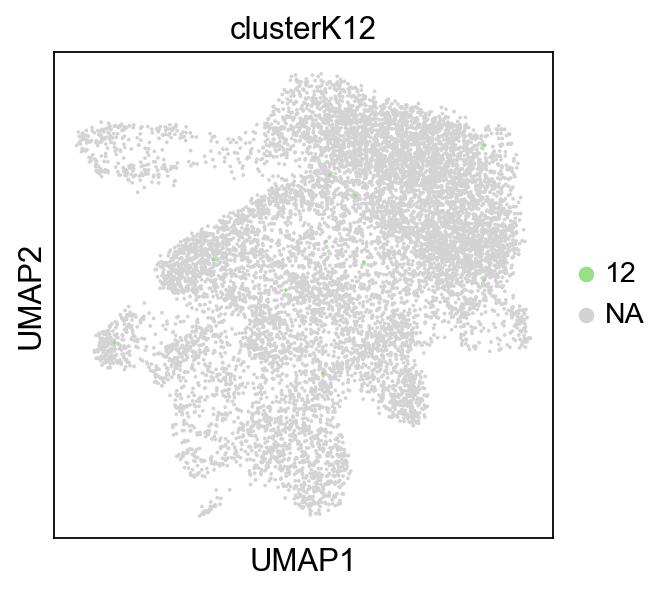

In [129]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [130]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

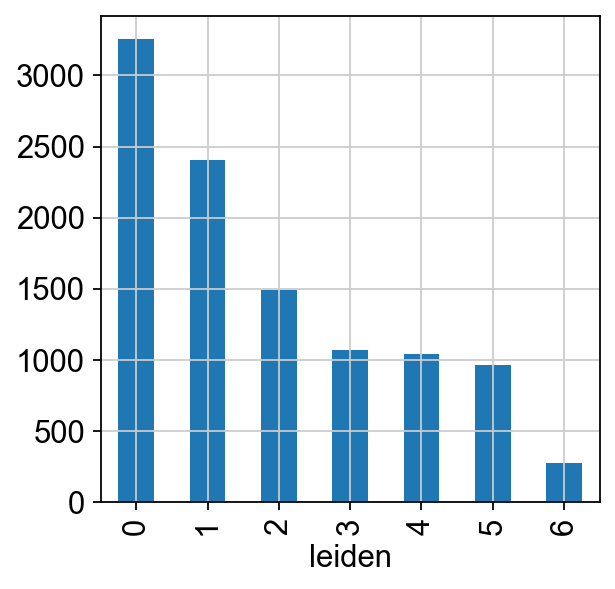

In [131]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

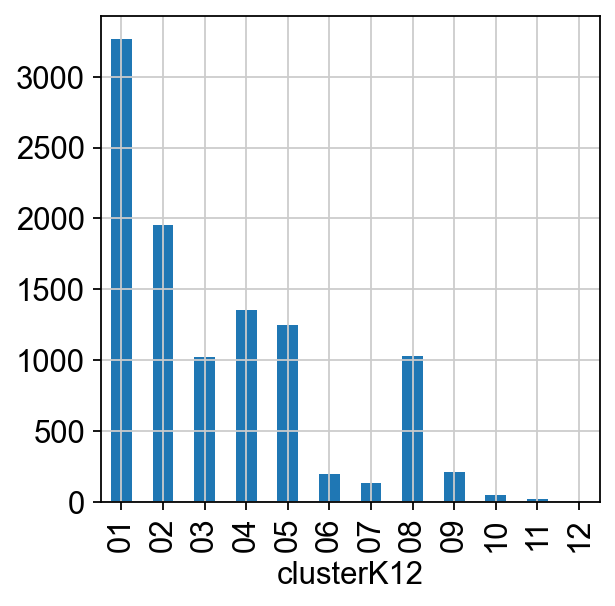

In [132]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

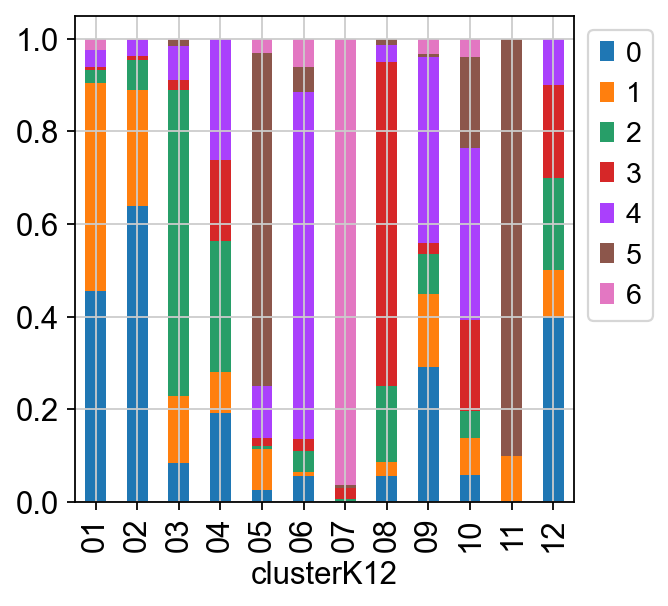

In [133]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [134]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,01,7.216294e-01,8.925562e-02,0.001270,0.105624,0.000054,0.006840,0.011382,0.001134,0.026761,0.003153,0.015806,0.017092,0.721629
1,03,3.367581e-02,2.188396e-02,0.343284,0.111102,0.000206,0.128750,0.012944,0.096489,0.016271,0.128091,0.051292,0.056011,0.343284
2,08,1.531669e-06,6.598303e-07,0.000018,0.002572,0.000005,0.000011,0.000132,0.996267,0.000388,0.000064,0.000061,0.000480,0.996267
3,02,4.113207e-05,5.581707e-01,0.244485,0.038371,0.000232,0.028301,0.010034,0.037221,0.052993,0.011072,0.007488,0.011592,0.558171
4,08,1.053149e-07,9.339428e-08,0.000199,0.000003,0.005454,0.000031,0.000208,0.993063,0.000024,0.000410,0.000084,0.000524,0.993063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10502,04,1.912763e-06,2.398865e-02,0.000336,0.810595,0.000256,0.001784,0.001851,0.021529,0.036125,0.101511,0.001622,0.000400,0.810595
10503,01,5.879458e-01,9.254704e-02,0.006291,0.040467,0.013318,0.013547,0.033516,0.013170,0.085223,0.022450,0.036291,0.055234,0.587946
10504,04,5.341046e-03,5.333138e-04,0.033113,0.643066,0.019311,0.030422,0.011254,0.136689,0.051281,0.027560,0.013634,0.027797,0.643066
10505,01,8.802711e-01,6.684291e-02,0.004636,0.001329,0.011000,0.005308,0.004288,0.000571,0.008204,0.000628,0.010641,0.006281,0.880271


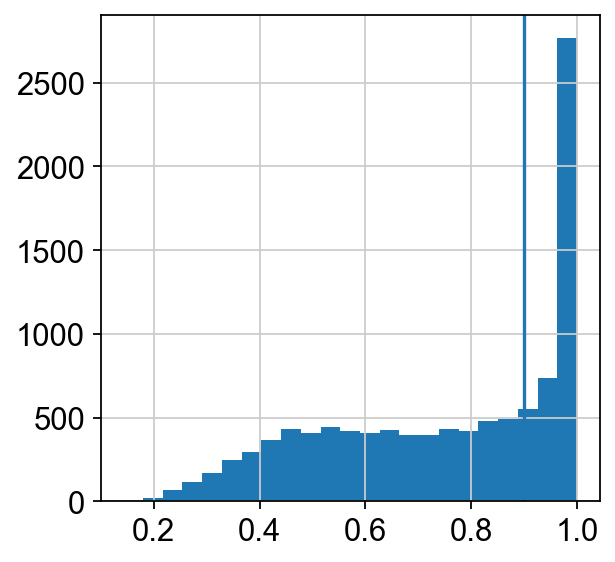

In [135]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [136]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.14-0.46,0.141,0.458
1,0.46-0.59,0.458,0.590
2,0.59-0.73,0.590,0.727
3,0.73-0.86,0.727,0.855
4,0.86-0.95,0.855,0.951
5,0.95-1.0,0.951,0.997
6,1.0-1.0,0.997,1.000


In [137]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_301/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y 

In [138]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCAAAGAAGCCTC-1    other
AAACCAAAGAAGCGCA-1    other
AAACCAAAGCCGATTA-1       08
AAACCAAAGCGGATTC-1    other
AAACCAAAGTCAAGGG-1       08
                      ...  
TGTGTTAGTTGAAGGC-1       04
TGTGTTGAGCGATAGG-1    other
TGTGTTGAGGGGACAC-1    other
TGTGTTGAGGTAAGCG-1       01
TGTGTTGAGTTGCGTA-1    other
Name: clusterK12_stringent, Length: 10507, dtype: object

In [139]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

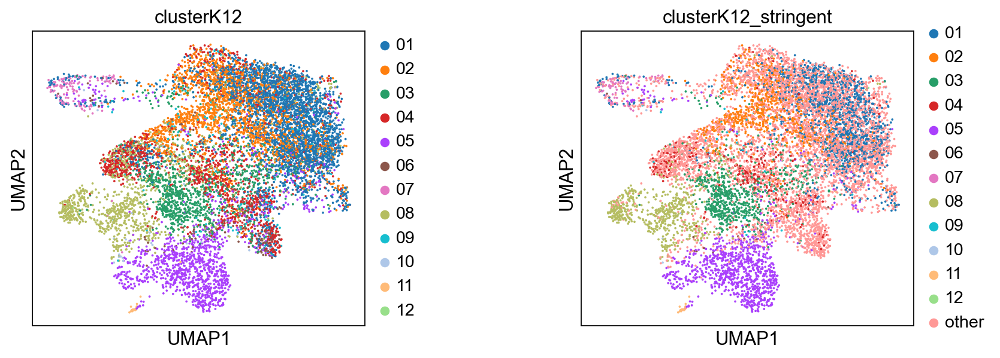

In [140]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

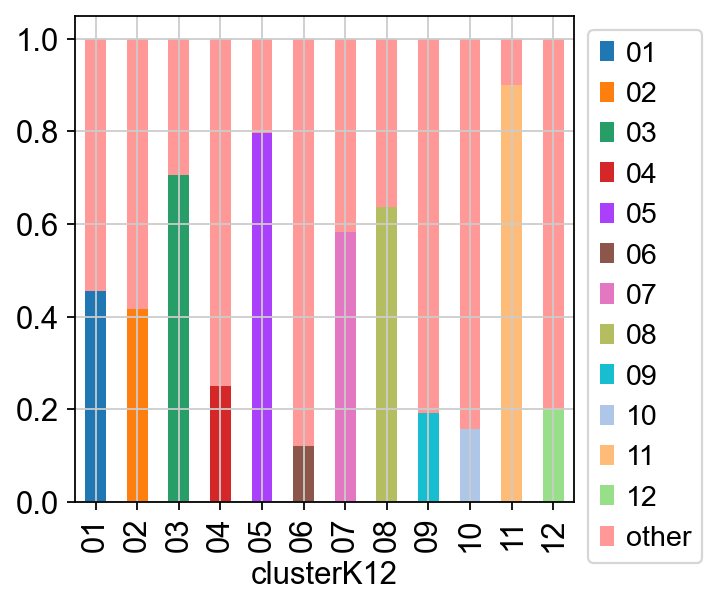

In [141]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

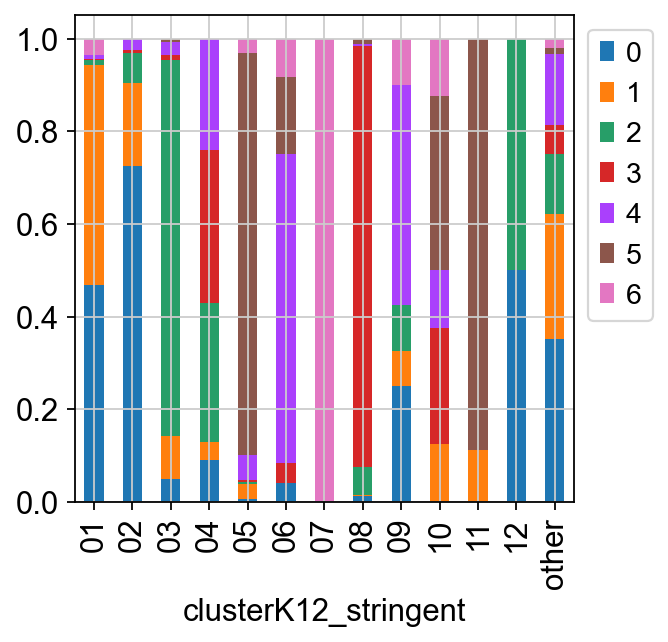

In [142]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

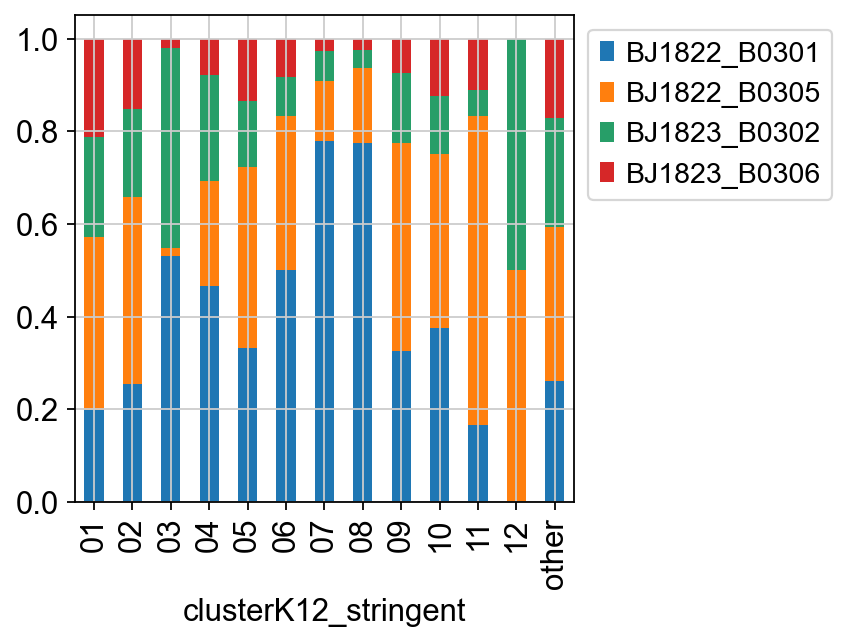

In [143]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

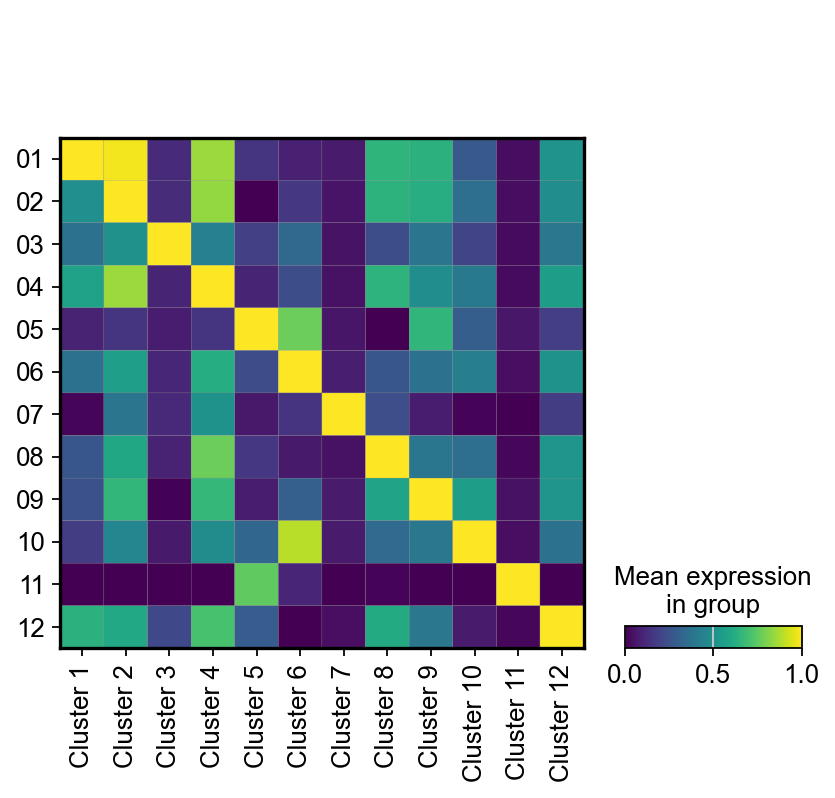

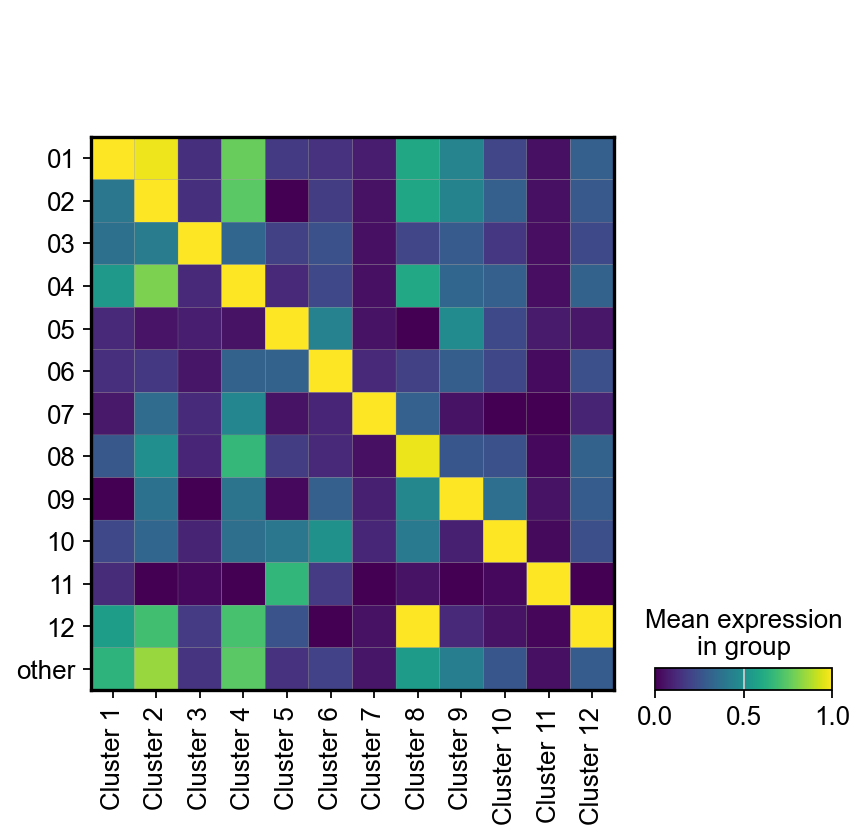

In [144]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

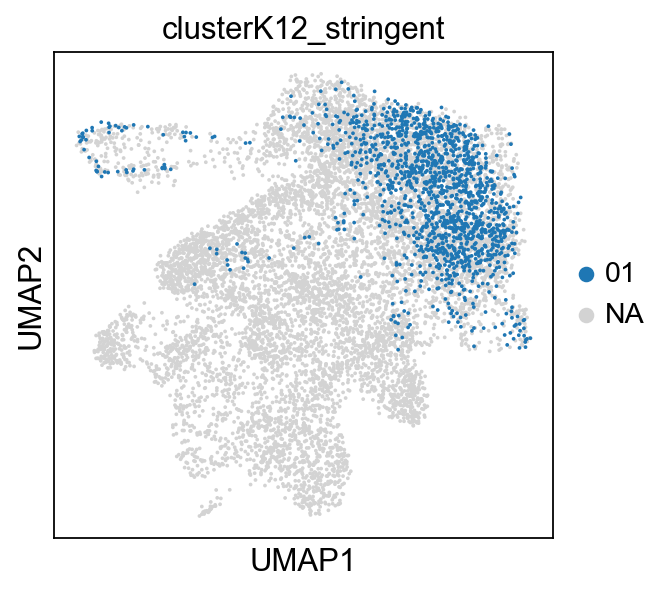

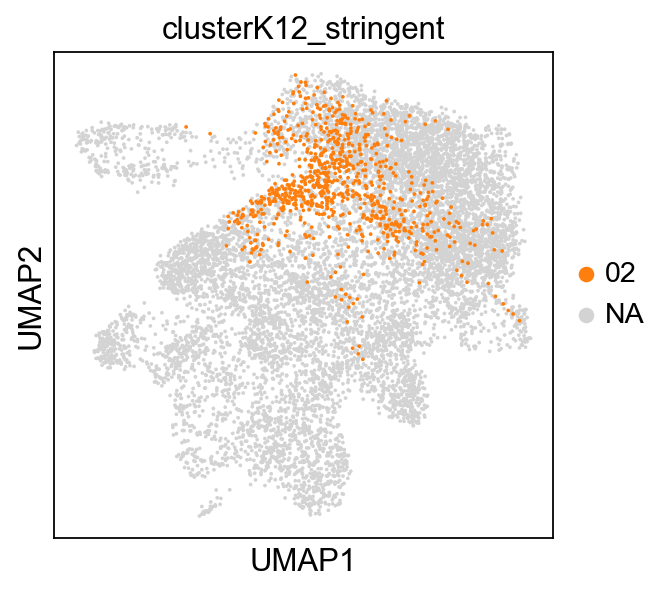

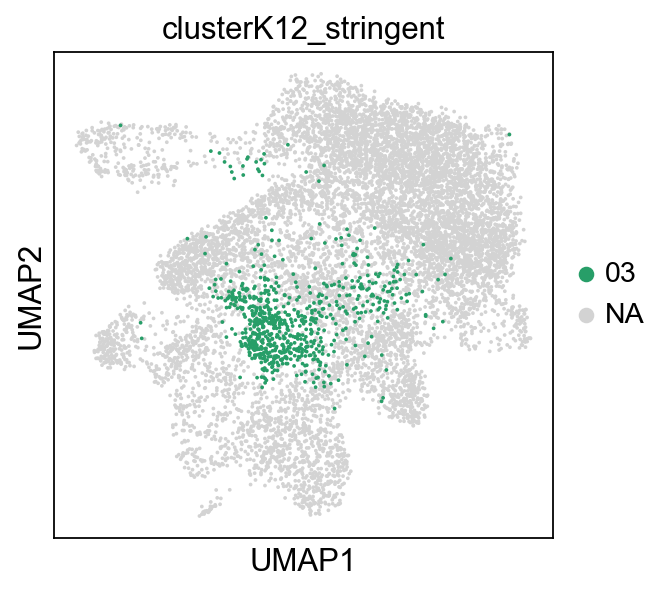

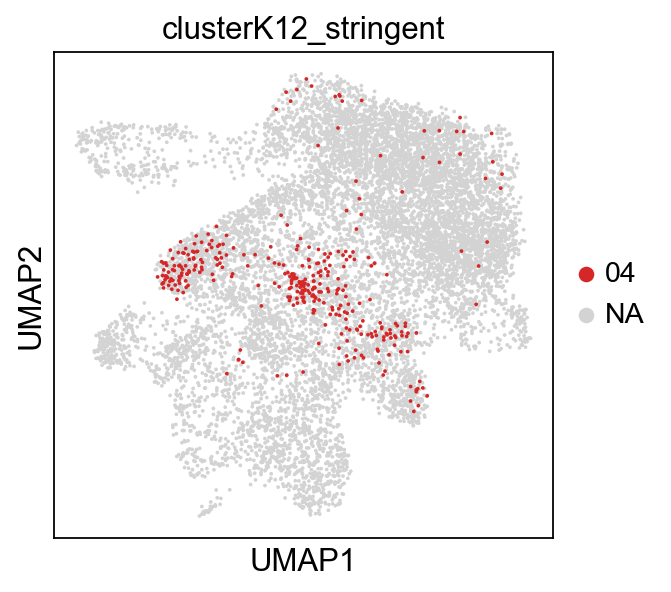

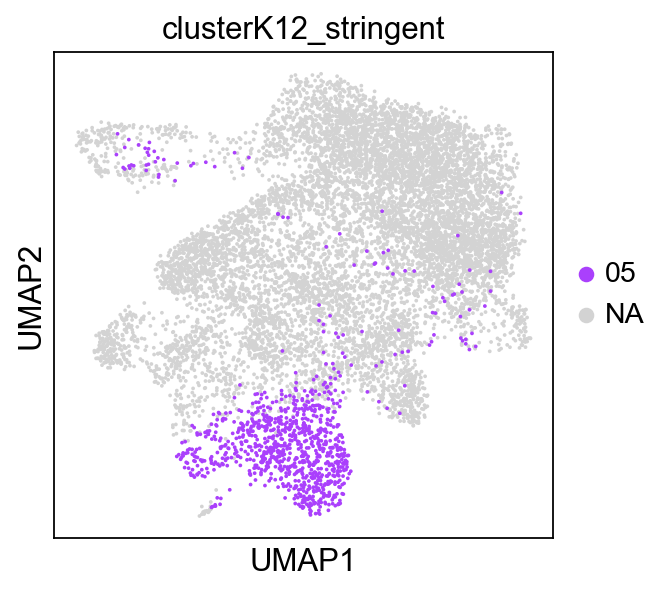

...

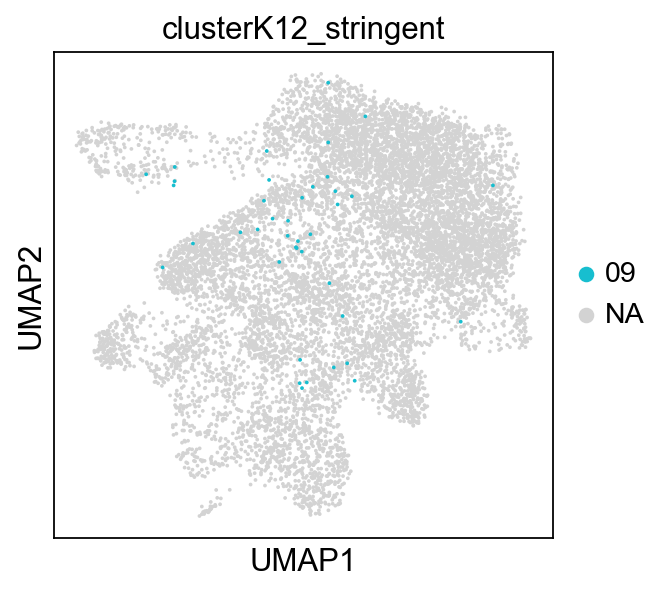

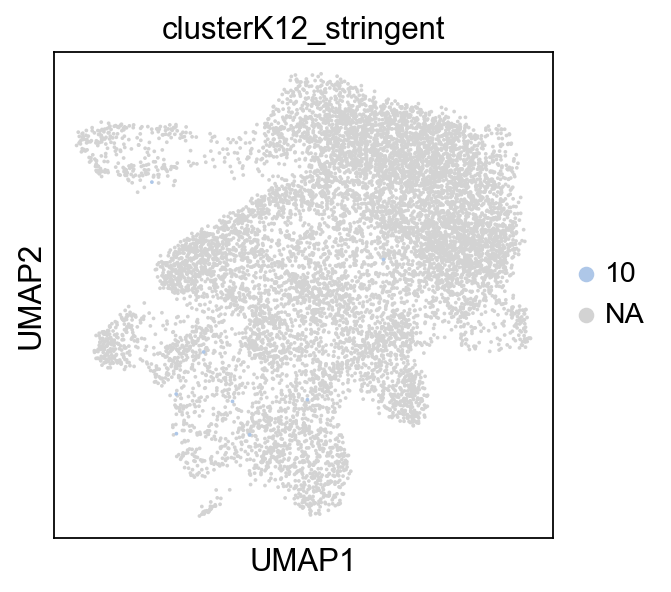

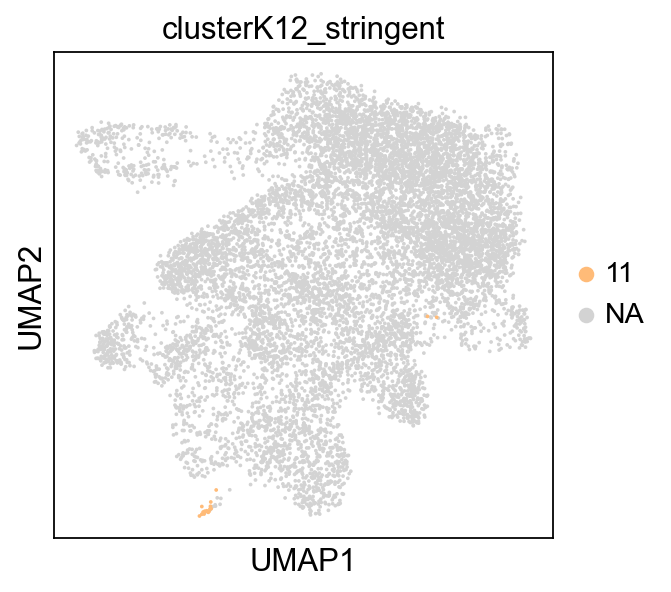

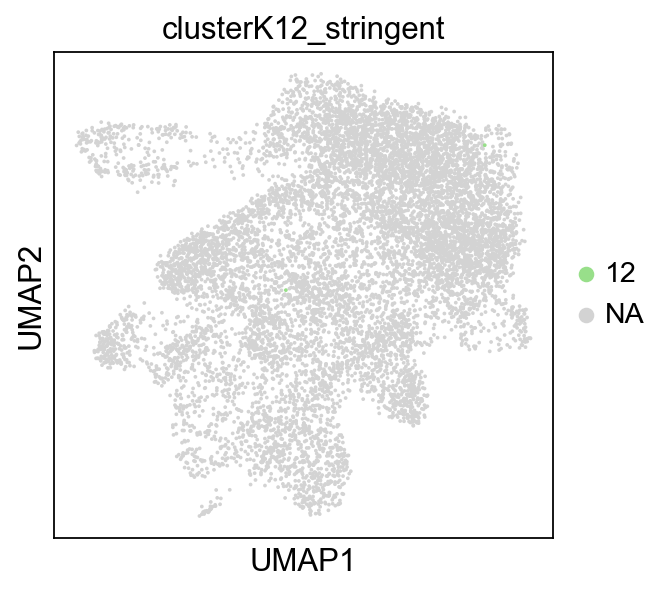

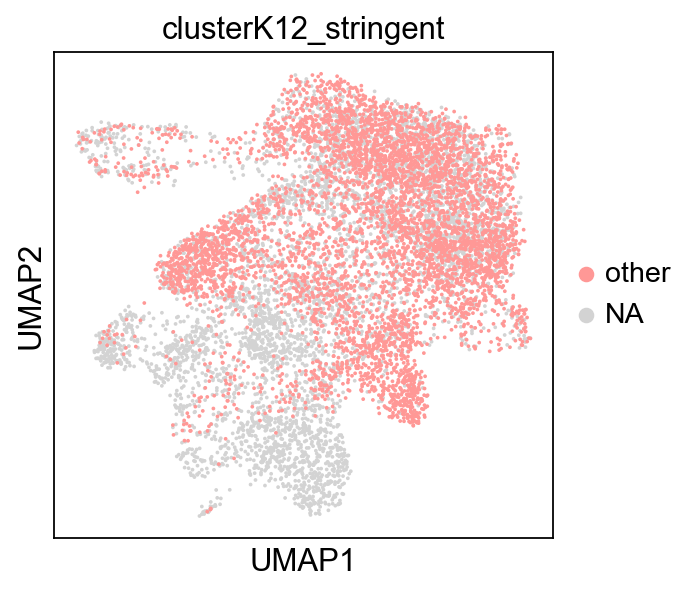

In [145]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [146]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
01    3267
02    1956
04    1358
05    1246
08    1033
03    1026
09     209
06     199
07     132
10      51
11      20
12      10
Name: count, dtype: int64

In [147]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

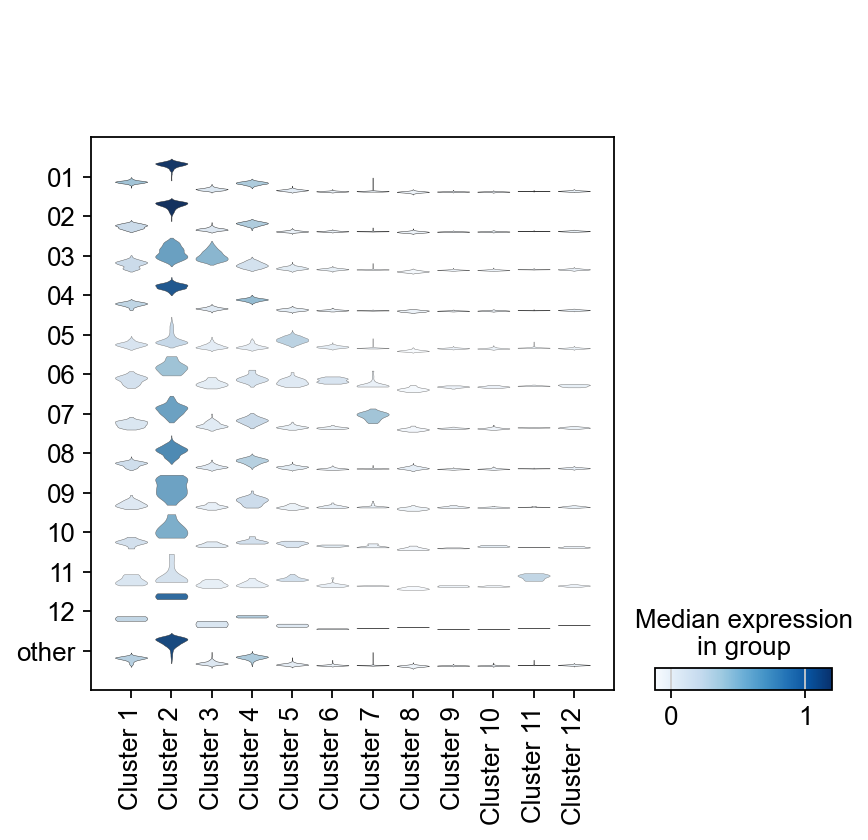

In [148]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

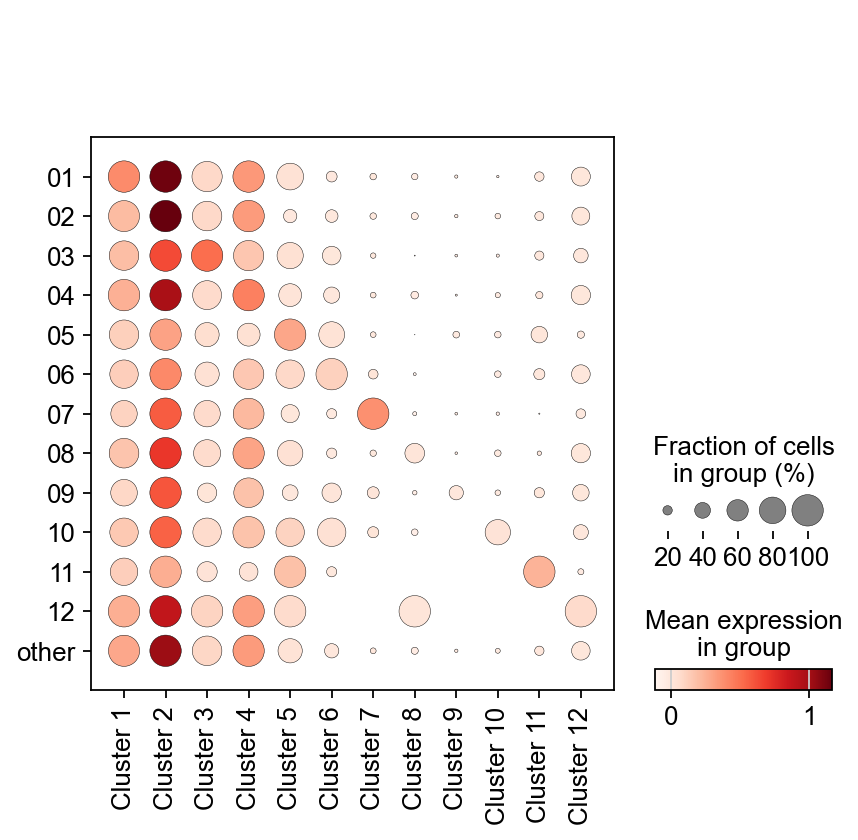

In [149]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

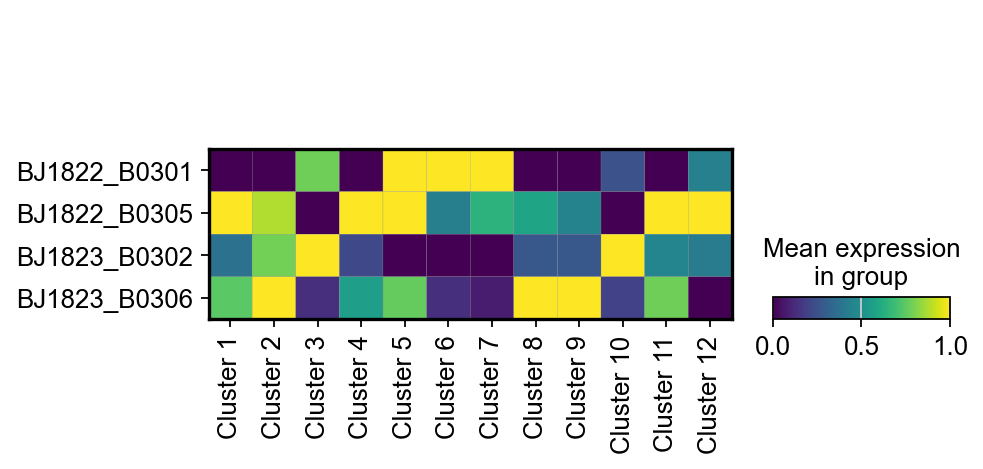

In [150]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [151]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

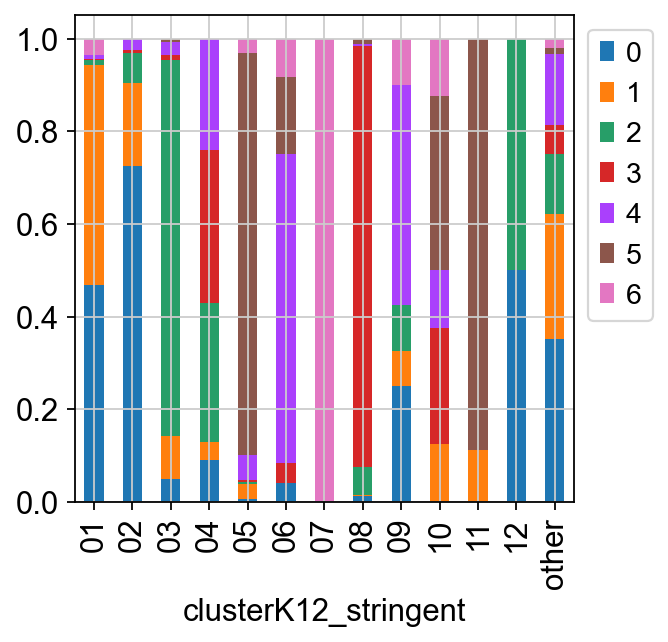

In [152]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

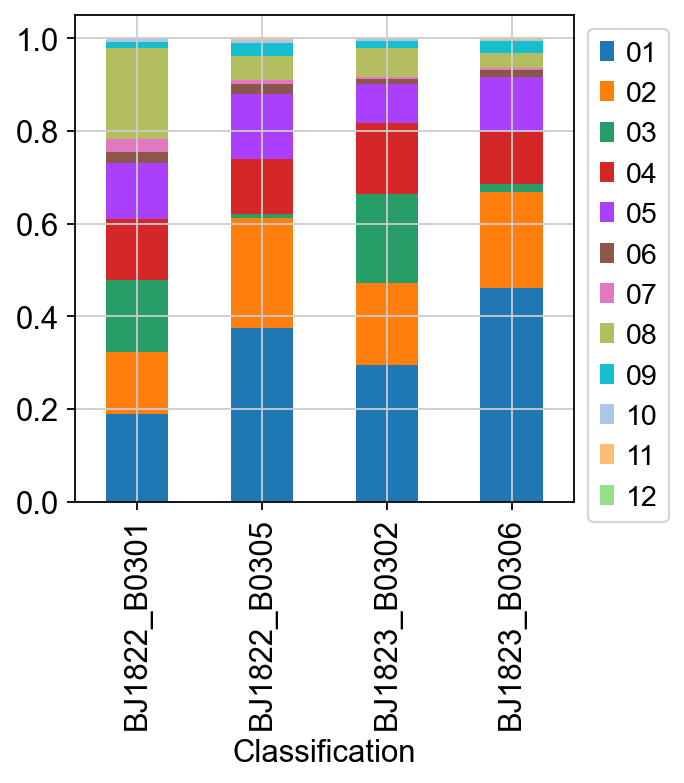

In [153]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

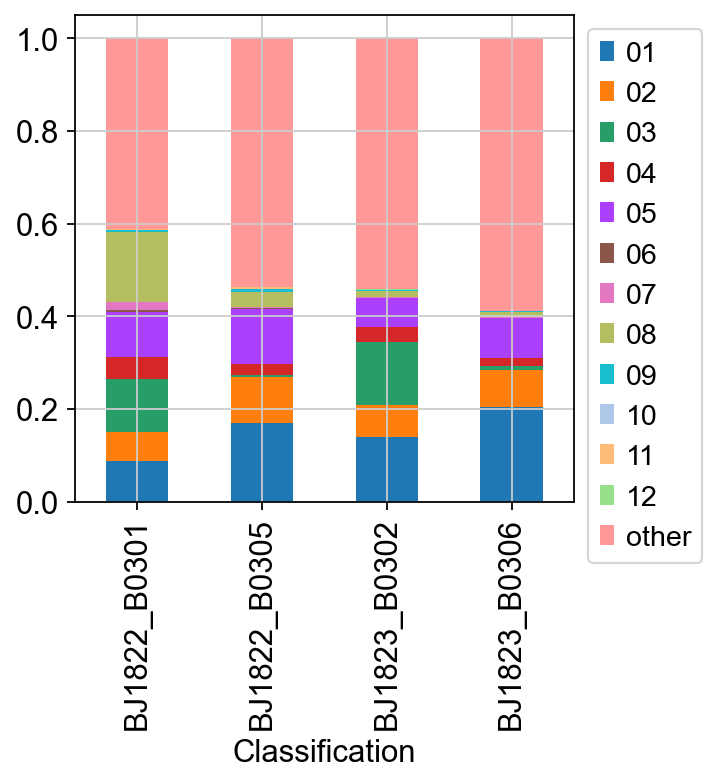

In [154]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Examine Groupings

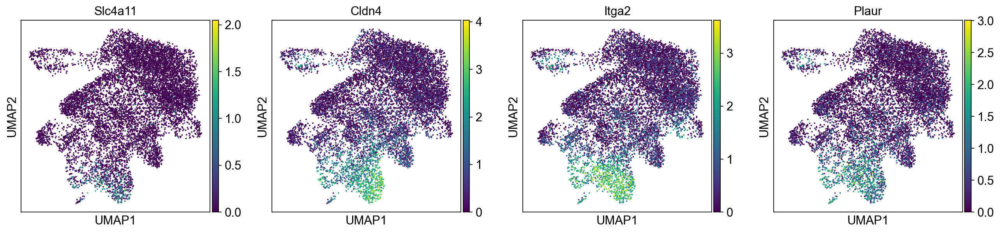

In [155]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

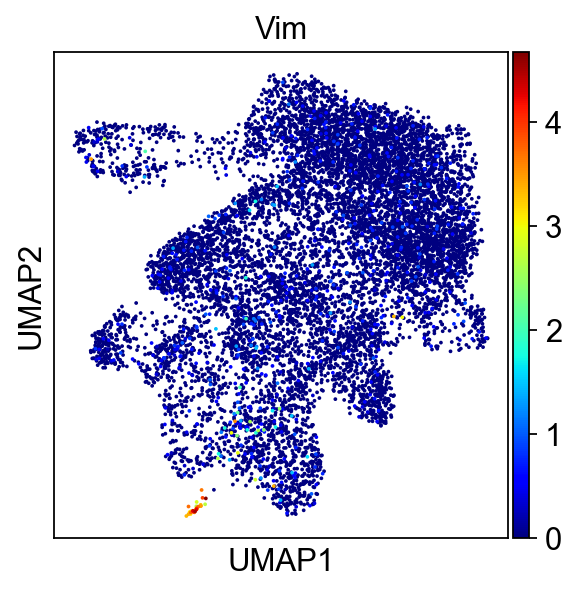

In [156]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

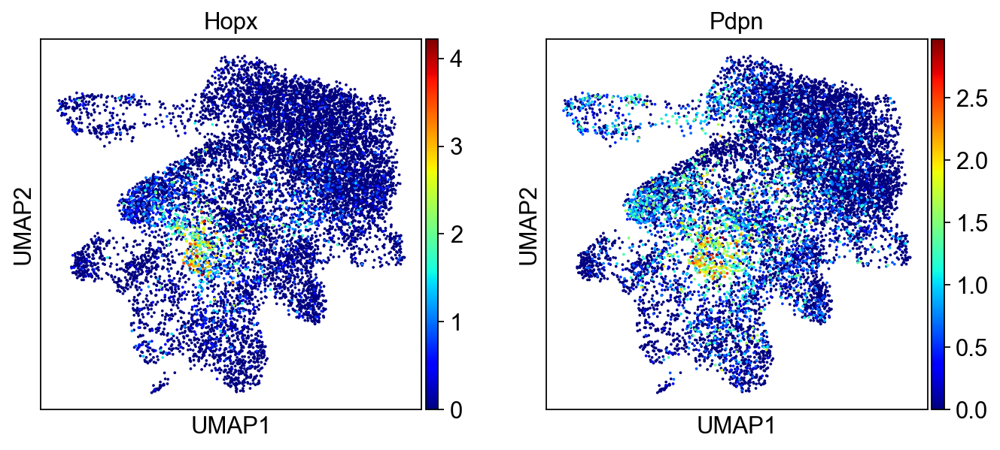

In [157]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

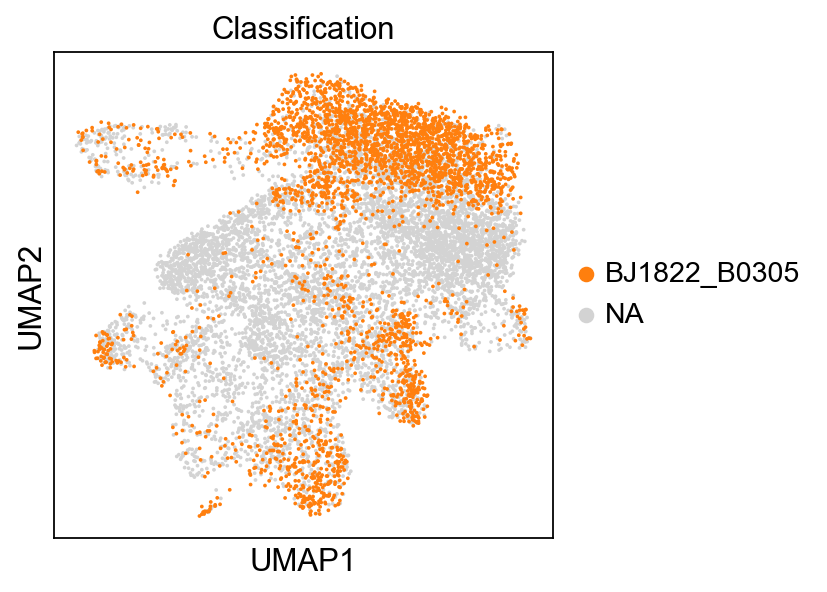

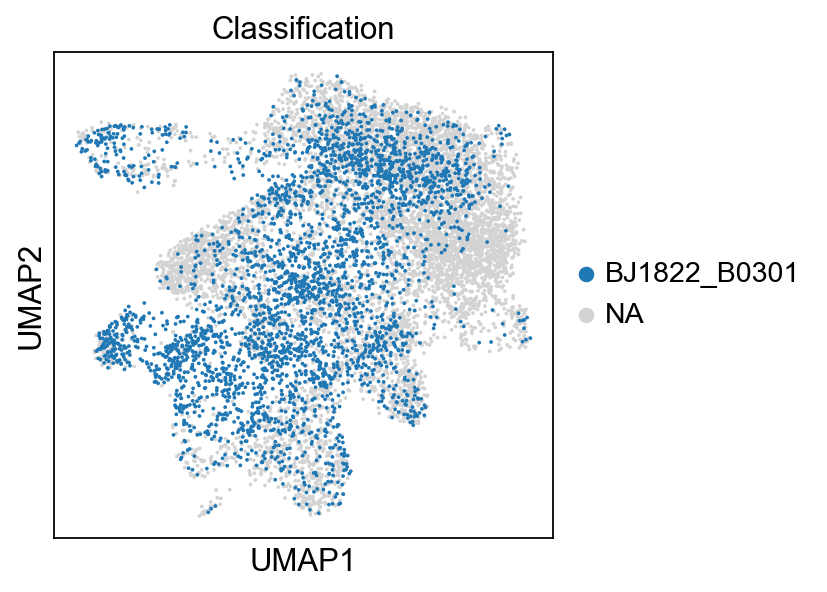

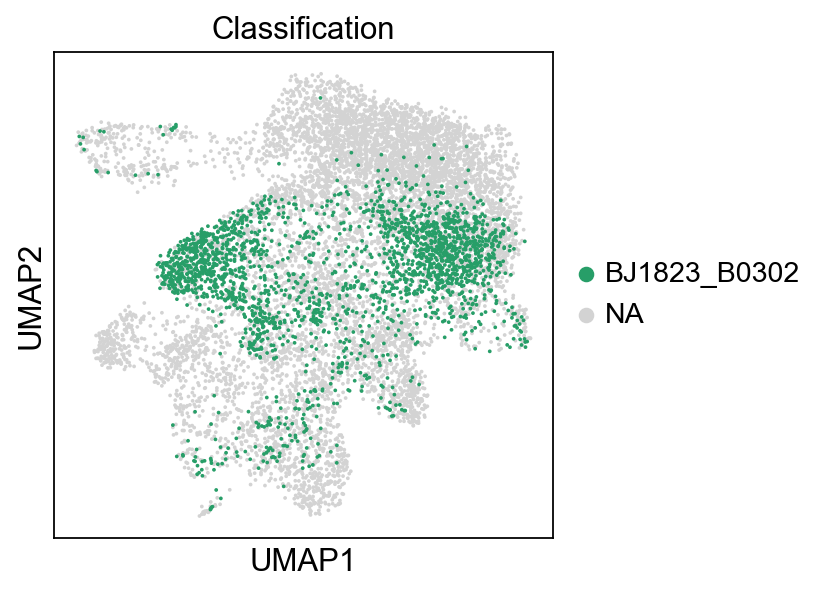

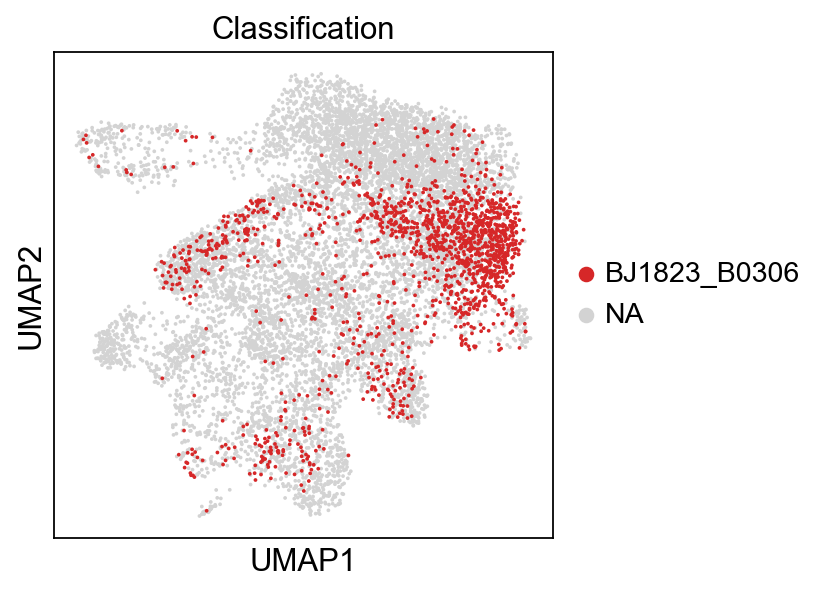

In [158]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [159]:
sc.tl.embedding_density(adata,basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


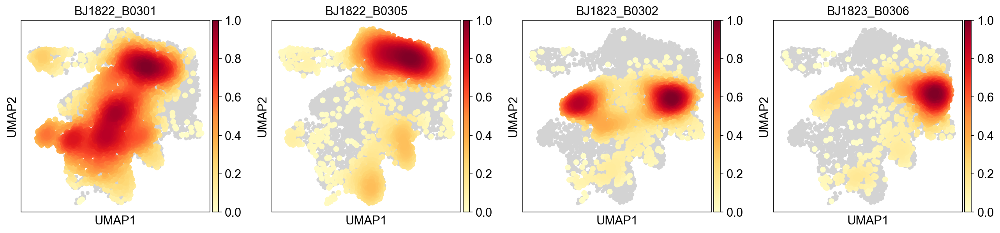

In [160]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Classification', groups=samples)

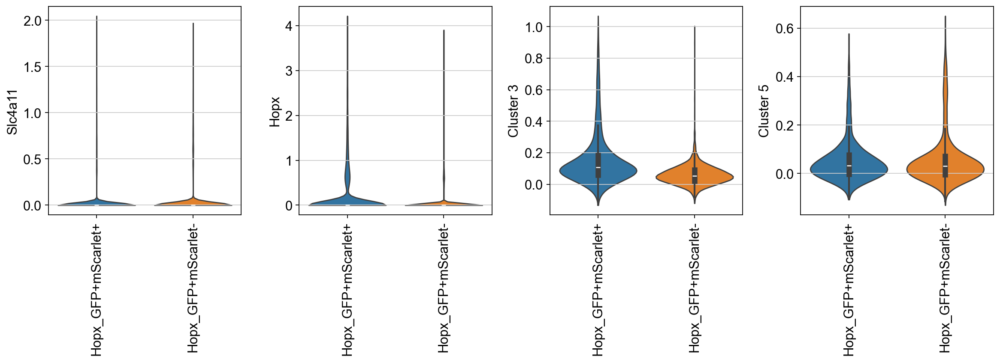

In [161]:
sc.pl.violin(adata, ['Slc4a11','Hopx','Cluster 3','Cluster 5',], 
             groupby='Group',rotation=90,inner='box',stripplot=False)

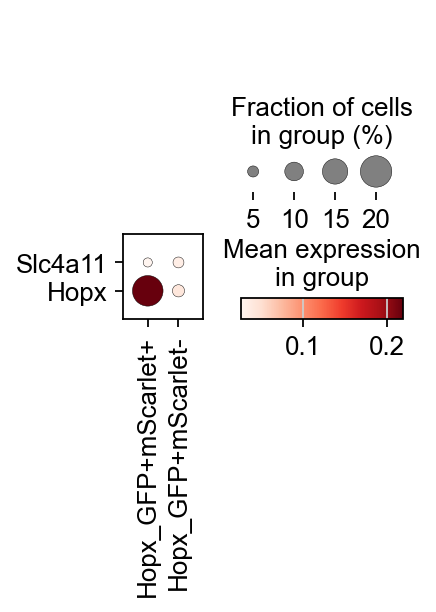

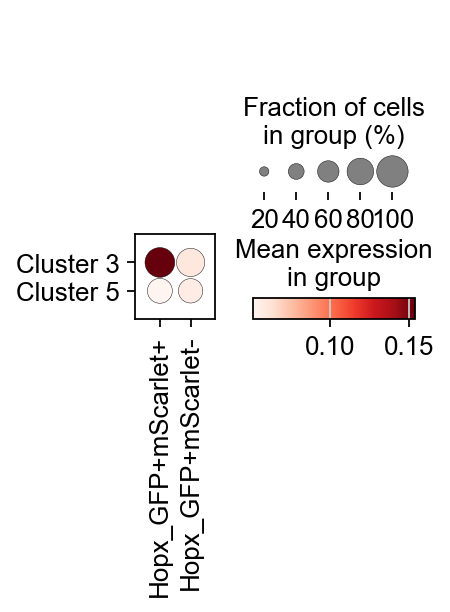

In [162]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx'], groupby='Group',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5'], groupby='Group',swap_axes=True)

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


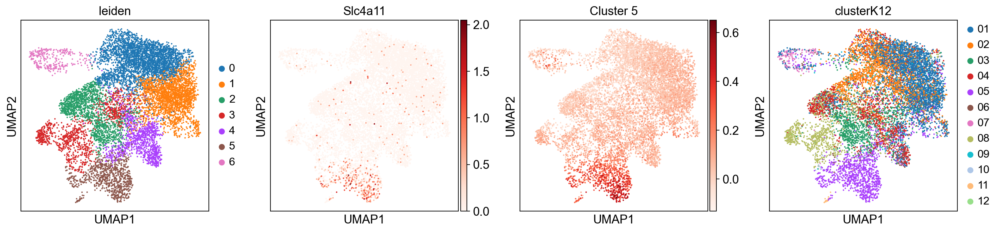

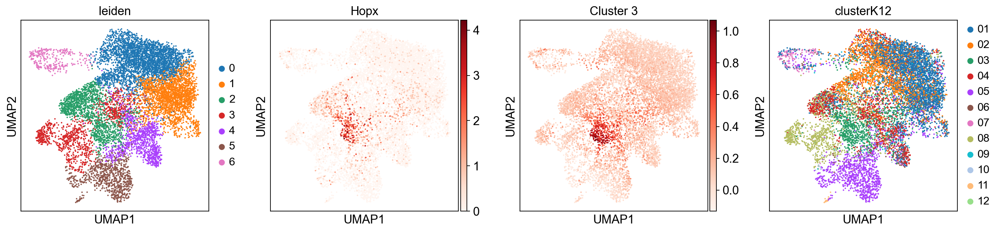

In [163]:
sc.tl.leiden(adata, resolution=.4)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5', 'clusterK12'], cmap='Reds')
sc.pl.umap(adata, color=['leiden','Hopx','Cluster 3', 'clusterK12'], cmap='Reds')

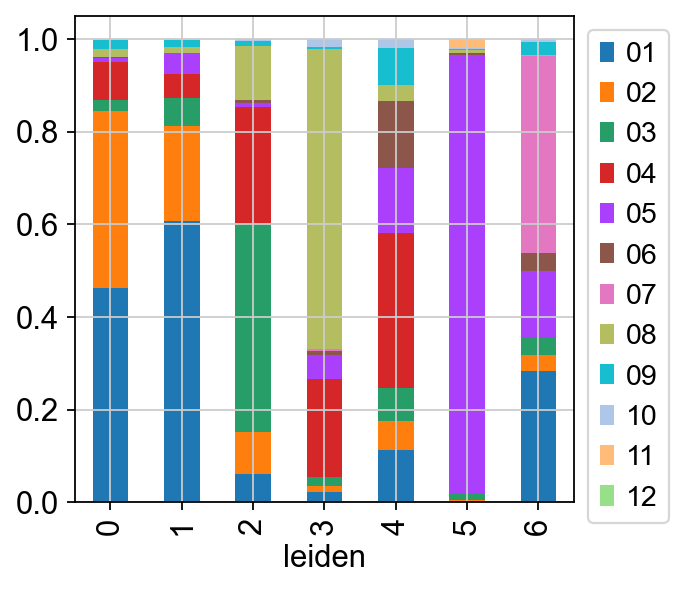

In [164]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

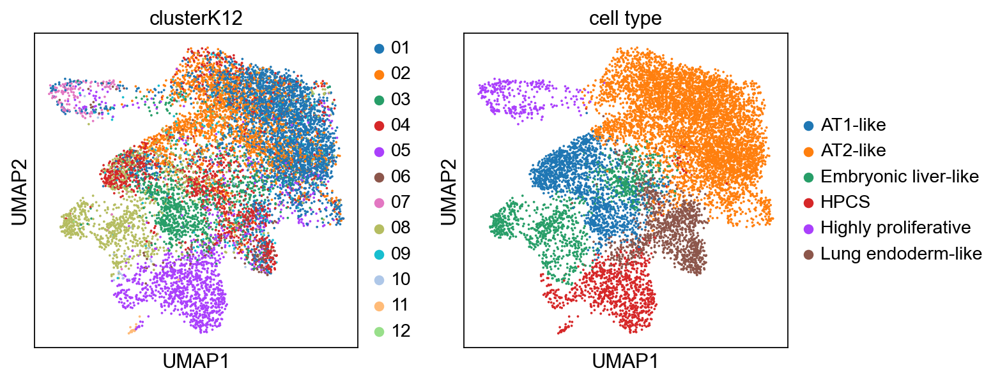

In [165]:
cluster2annotation = {
    "0": "AT2-like",
    "1": "AT2-like",
    "2": "AT1-like",
    "3": "Embryonic liver-like",
    "4": "Lung endoderm-like",
    "5": "HPCS",
    "6": "Highly proliferative",
}
adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")
sc.pl.umap(adata, color=['clusterK12','cell type'])

In [166]:
adata.uns['cell type_colors']=['#1f77b4', '#279e68', '#aa40fc', '#d62728', '#e377c2','#8c564b']

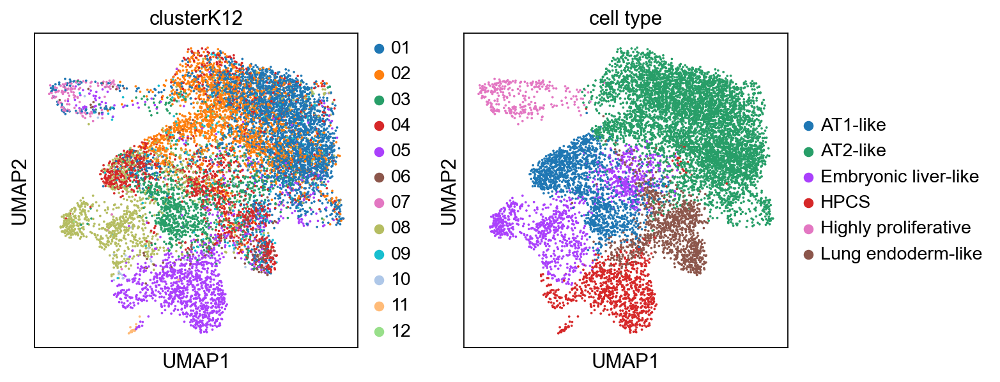

In [167]:
sc.pl.umap(adata, color=['clusterK12','cell type'])

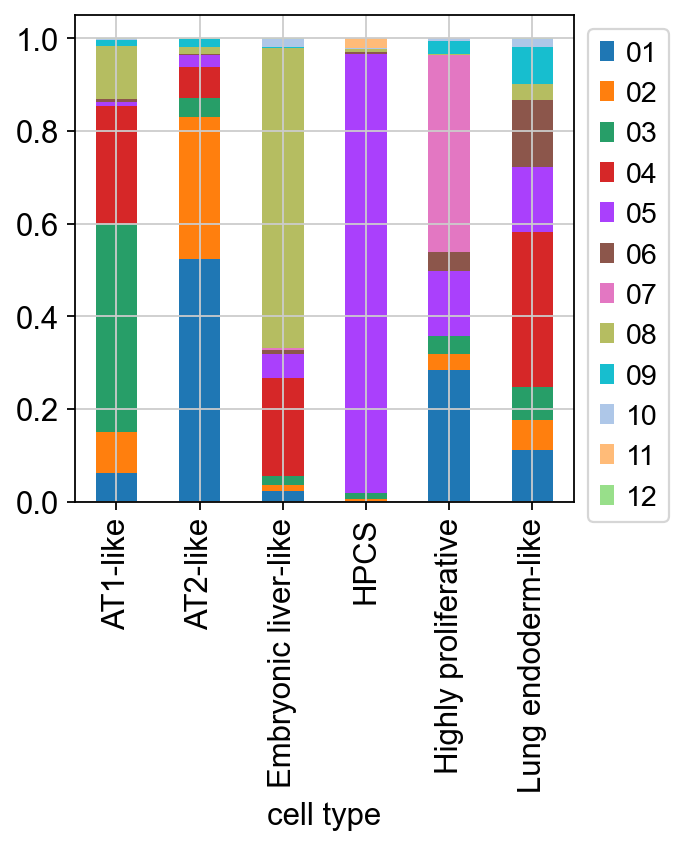

In [168]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['cell type'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Figures for paper

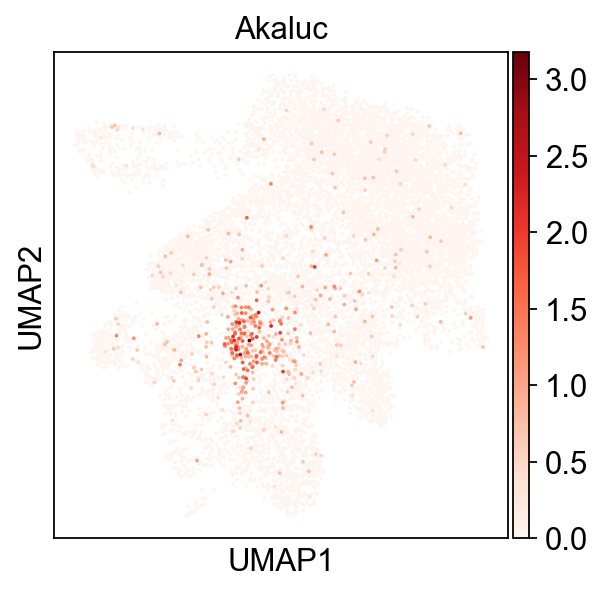

In [169]:
sc.pl.umap(adata, color='Akaluc',cmap="Reds", save="figures/Ext_Fig_8i_Akaluc.svg")

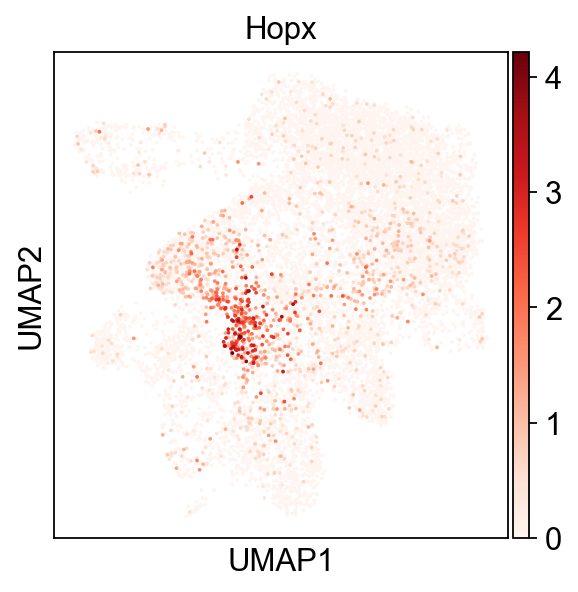

In [170]:
sc.pl.umap(adata, color='Hopx',cmap="Reds", save="figures/Ext_Fig_8i_Hopx.svg")

In [171]:
oldorder = adata.obs['Classification'].cat.categories
oldorder

Index(['BJ1822_B0301', 'BJ1822_B0305', 'BJ1823_B0302', 'BJ1823_B0306'], dtype='object')

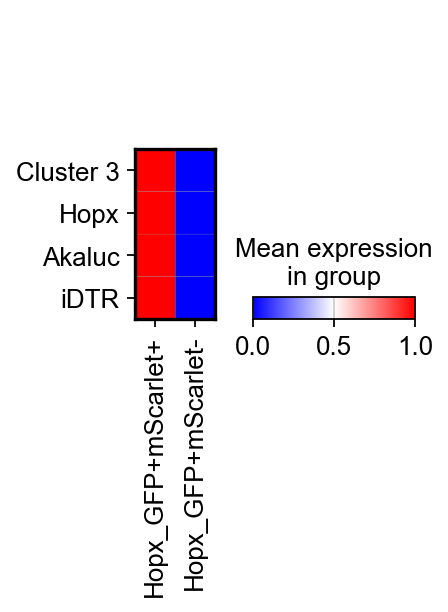

In [172]:
# Here Cluster 3 = AT1-like cell state
adata.obs['Classification'] = adata.obs['Classification'].astype(pd.CategoricalDtype(categories=['BJ1822_B0301', 'BJ1823_B0302', 'BJ1822_B0305','BJ1823_B0306','BJ1187_B0303', 'BJ1187_B0308', 'BJ1192_B0304', 'BJ1192_B0310'], ordered=True))
sc.pl.matrixplot(adata[adata.obs.Group.isin(['Hopx_GFP+mScarlet+','Hopx_GFP+mScarlet-']),:], ['Cluster 3','Hopx','Akaluc','iDTR'],'Group',cmap='bwr',swap_axes=True,standard_scale='var',save='Ext_Fig_8j_matrixplot_groupscaled.svg')

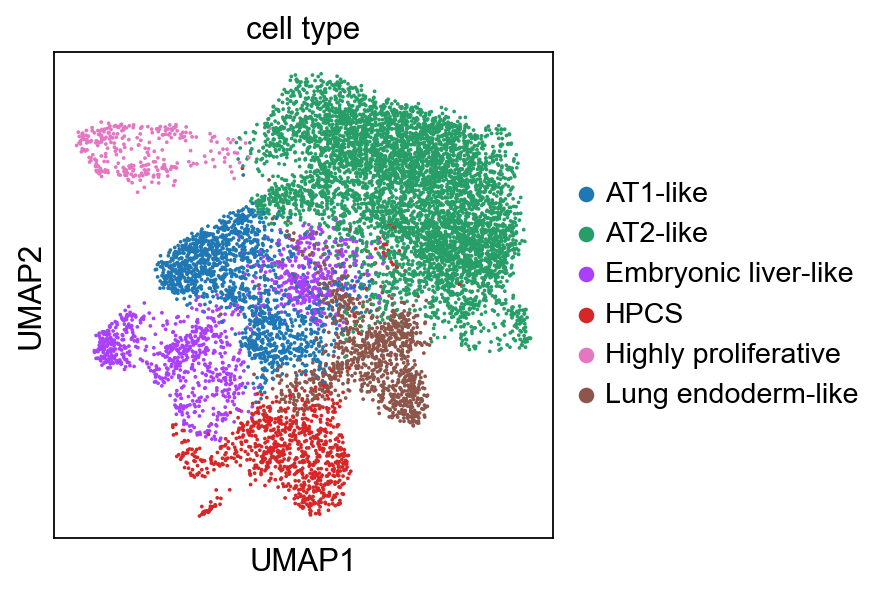

In [173]:
sc.pl.umap(adata, color=['cell type'], cmap='Reds', save='Ext_Fig_8h_cell type.svg')

## Quantify Hopx expression in AT1-like vs other Clusters in single cell data

In [174]:
adata.obs['Hopx_obs'] = [1 if x else 0 for x in adata[:,'Hopx'].X != adata[:,'Hopx'].X.min()]

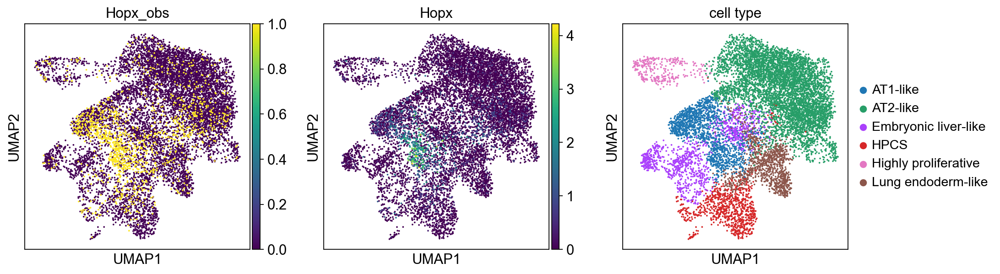

In [175]:
sc.pl.umap(adata, color=['Hopx_obs', 'Hopx','cell type'])

In [176]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'], normalize='columns')

Hopx_obs,0,1
cell type,,
AT1-like,0.093774,0.477339
AT2-like,0.572273,0.285819
Embryonic liver-like,0.115330,0.051170
HPCS,0.085349,0.081871
Highly proliferative,0.028887,0.025585
Lung endoderm-like,0.104388,0.078216


In [177]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'])

Hopx_obs,0,1
cell type,,
AT1-like,857,653
AT2-like,5230,391
Embryonic liver-like,1054,70
HPCS,780,112
Highly proliferative,264,35
Lung endoderm-like,954,107


In [178]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs']).sum()

Hopx_obs
0    9139
1    1368
dtype: int64

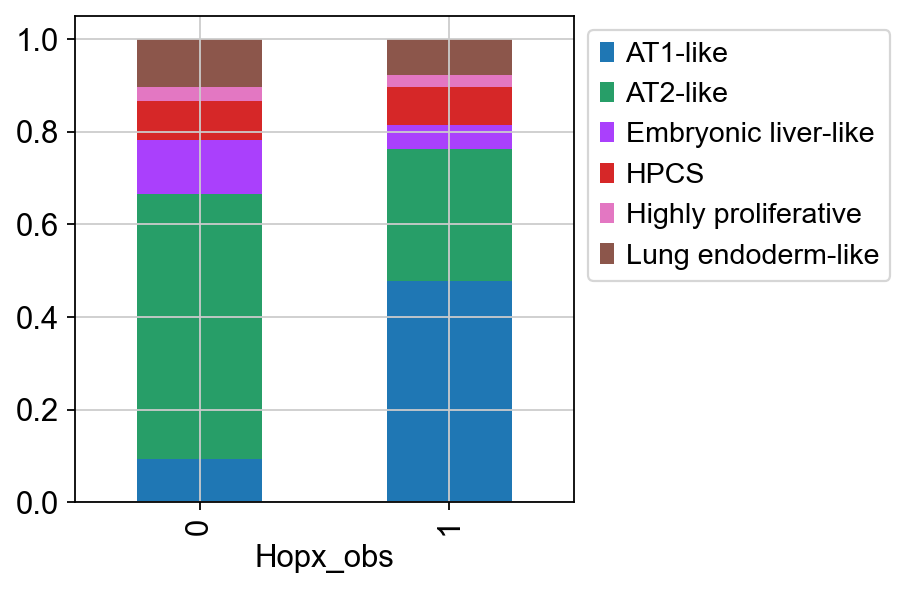

In [179]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

## Quantify iDTR expression in AT1-like vs other Clusters in single cell data

In [180]:
adata.obs['iDTR_obs'] = [1 if x else 0 for x in adata[:,'iDTR'].X != adata[:,'iDTR'].X.min()]

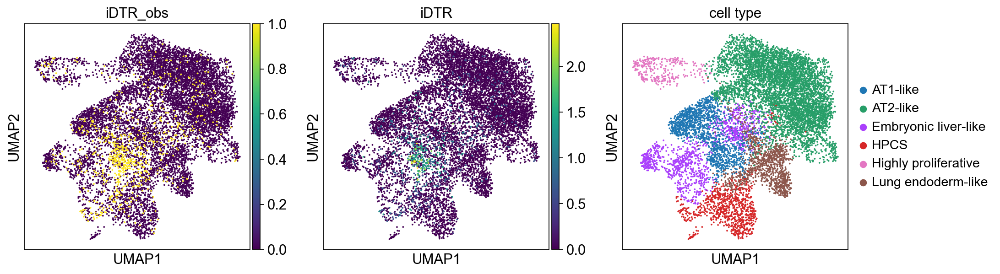

In [181]:
sc.pl.umap(adata, color=['iDTR_obs', 'iDTR','cell type'])

In [182]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'], normalize='columns')

iDTR_obs,0,1
cell type,,
AT1-like,0.120181,0.427329
AT2-like,0.562049,0.208696
Embryonic liver-like,0.106267,0.115528
HPCS,0.079880,0.145342
Highly proliferative,0.028139,0.032298
Lung endoderm-like,0.103484,0.070807


In [183]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'])

iDTR_obs,0,1
cell type,,
AT1-like,1166,344
AT2-like,5453,168
Embryonic liver-like,1031,93
HPCS,775,117
Highly proliferative,273,26
Lung endoderm-like,1004,57


In [184]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs']).sum()

iDTR_obs
0    9702
1     805
dtype: int64

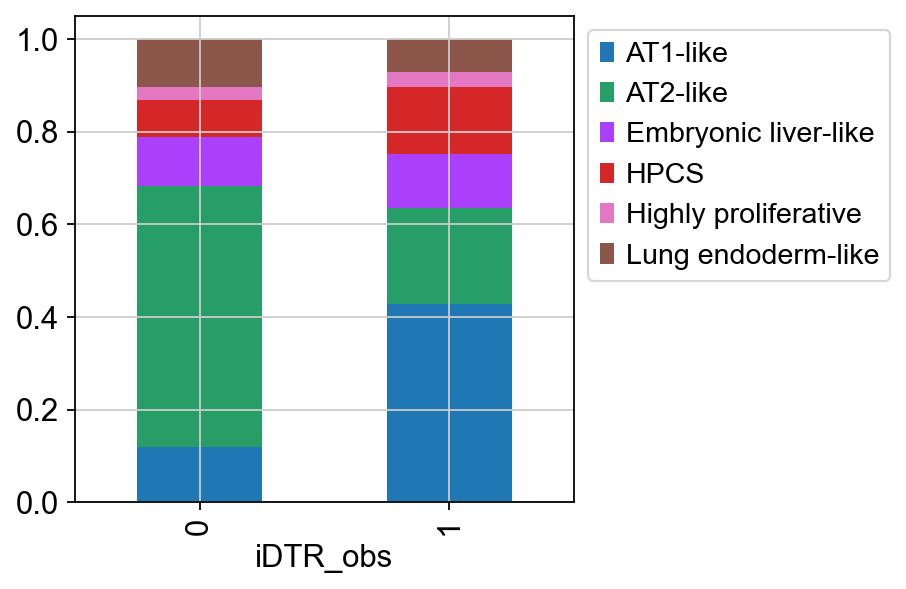

In [185]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

## Quantify Slc4a11 expression in AT1-like vs other Clusters in single cell data

In [186]:
adata.obs['Slc4a11_obs'] = [1 if x else 0 for x in adata[:,'Slc4a11'].X != adata[:,'Slc4a11'].X.min()]

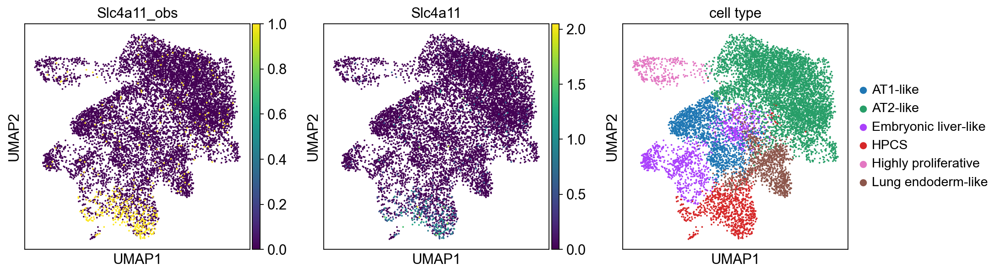

In [187]:
sc.pl.umap(adata, color=['Slc4a11_obs', 'Slc4a11','cell type'])

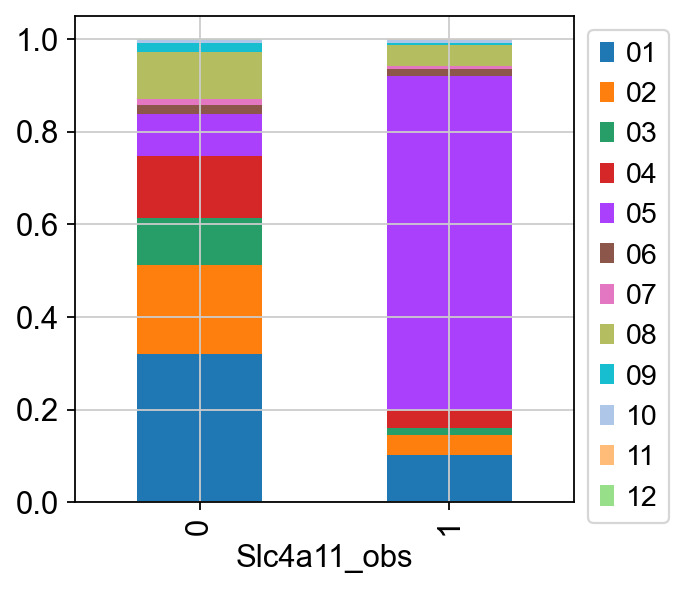

In [188]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Slc4a11_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [189]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'], normalize='columns')

Slc4a11_obs,0,1
cell type,,
AT1-like,0.148911,0.028634
AT2-like,0.551776,0.162996
Embryonic liver-like,0.108724,0.068282
HPCS,0.058888,0.660793
Highly proliferative,0.028748,0.022026
Lung endoderm-like,0.102954,0.057269


In [190]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'])

Slc4a11_obs,0,1
cell type,,
AT1-like,1497,13
AT2-like,5547,74
Embryonic liver-like,1093,31
HPCS,592,300
Highly proliferative,289,10
Lung endoderm-like,1035,26


In [191]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs']).sum()

Slc4a11_obs
0    10053
1      454
dtype: int64

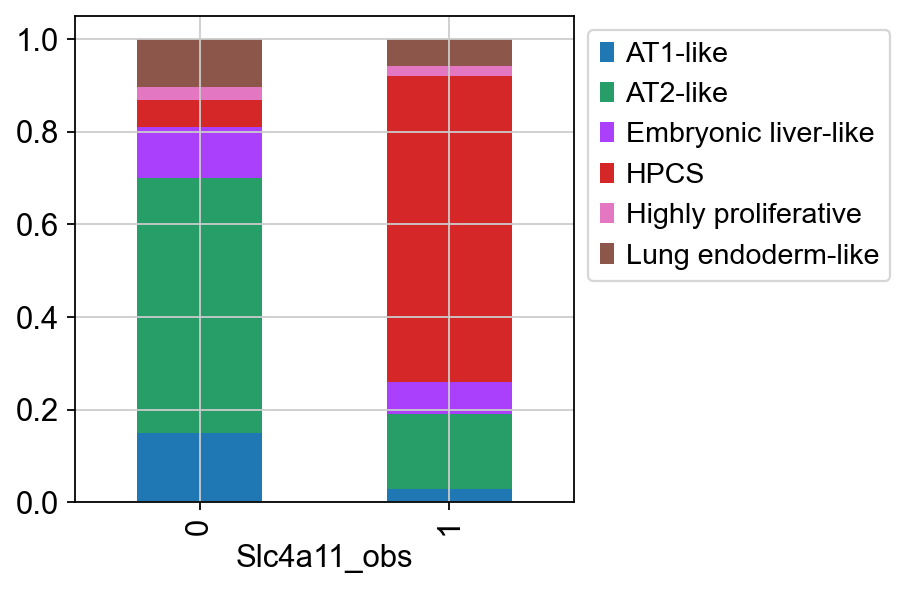

In [192]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

# Save the result

In [193]:
adata.write(results_file, compression='gzip')